<div style="padding:8px; color:#ECEEF1; margin:0.3; font-size:190%; text-align:center; display:fill; border-radius:5px; background-color:#42659A; overflow:hidden; font-weight:250; font-family:helvetica;"> Project - California Housing</div>

<div style="padding:8px; color:#ECEEF1; margin:0.3; font-size:190%; text-align:center; display:fill; border-radius:5px; background-color:#617A9A; overflow:hidden; font-weight:270; font-family:helvetica;"> Notebook 001</div>
<br>

<H2 style="padding:1px; font-family:helvetica; padding-left:0px"> This Notebook Contains:</H2>

<H3 style="padding:1px; font-family:helvetica; padding-left:20px"> Data Preprocessing </H3>
<H4 style="padding:1px; font-family:helvetica; padding-left:20px"> Train Validation Test Split</H4>

<H3 style="padding:1px; font-family:helvetica; padding-left:20px"> Feature Engineering </H3>

<H3 style="padding:1px; font-family:helvetica; padding-left:20px"> Feature Selection </H3>

<H3 style="padding:1px; font-family:helvetica; padding-left:20px"> Model Creation </H3>

<H3 style="padding:1px; font-family:helvetica; padding-left:20px"> Model Metrics </H3>

<H2 style="padding:1px; font-family:helvetica; padding-left:0px"> Next Steps:</H2>

<H3 style="padding:1px; font-family:helvetica; padding-left:20px"> Model Performance Analysis </H3>

<H3 style="padding:1px; font-family:helvetica; padding-left:20px"> Model Selection </H3>

<H3 style="padding:1px; font-family:helvetica; padding-left:20px"> Data Preprocessing </H3>
<H4 style="padding:1px; font-family:helvetica; padding-left:20px"> Train Test Split</H4>

<H3 style="padding:1px; font-family:helvetica; padding-left:20px"> Feature Engineering </H3>

<H3 style="padding:1px; font-family:helvetica; padding-left:20px"> Feature Selection </H3>

<H3 style="padding:1px; font-family:helvetica; padding-left:20px"> Model Creation </H3>

<H3 style="padding:1px; font-family:helvetica; padding-left:20px"> Model Metrics </H3>

<H3 style="padding:1px; font-family:helvetica; padding-left:20px"> Model Performance Analysis </H3>

<H3 style="padding:1px; font-family:helvetica; padding-left:20px"> Conclusion </H3>

In [10]:
import numpy as np
import pandas as pd
import seaborn as sns

import matplotlib.pyplot as plt
%matplotlib inline

pd.set_option('display.max_columns', None)
pd.options.display.float_format = '{:.2f}'.format

df = pd.read_csv("/Users/luis/Documents/Proyects_To_Export/0261_DS_Projects/venv_0261_DS_Projects_311/Projects/0261_Project_002/0261_Project_002_Data/housing.csv")
#df = pd.read_csv("/xx/xx/Desktop/housing.csv")

# Dropping Missing Values
df.dropna(axis=0, inplace=True)

## X, y (features and labels)
X = df.drop(columns=["median_house_value"])
y = df["median_house_value"].copy()


## Feature Scaling
##Z-Score
import scipy.stats as stats

stats.zscore(a=X.select_dtypes('float'), axis=0)
feat1 = X.select_dtypes("float").apply(lambda x: stats.zscore(a=x, axis=0, ddof=0, nan_policy='propagate'))
feat1.agg(["mean", "std"])


### Feature Engineering
##Ocean Proximity
## Will use replace and True:1, False: 0
dummies_ocean_prox = pd.get_dummies(data=X["ocean_proximity"], drop_first=False)
dummies_ocean_prox = dummies_ocean_prox.replace({True: 1, False: 0})
dummies_ocean_prox.head(3)

features = pd.concat([feat1, dummies_ocean_prox], axis=1)
features

#### Features and Labels for Model Creation
X02 = features.copy()
y02 = df["median_house_value"].copy()


### Helper Functions
#### Functions Created to get repetitive information


In [11]:
# Helper Functions 001
def model_stats(model, model_used, model_name, param_grid_used=True):
    """
    Receives Trained Model information and outputs general information about the trained model

    Inputs
    model - Trained Model Variable Name. E.g. grid_model_001_001
    model_used - Name of the Model used to show which type of model the results are for. E.g. LogisticRegression
    model_name - Variable Name of the Model Object Created. E.g. log_model_001_001
    """
    print(f"Model: {model_used}")
    #print("\n")
    print(f" Model Object Variable Name: {model_name}")
    #print("\n")
    print(f"Trained Model Variable Name: {model}")
    #print("\n")
    if param_grid_used==True:
        parameter_grid_used = model.param_grid
        estimator_model = model.estimator
        best_params_model = model.best_params_
        best_estimator_model = model.best_estimator_
    
        print(f"Parameter Grid:\n{parameter_grid_used}")
        print("\n")
        print(f"Estimator:\n{estimator_model}")
        print("\n")
        print(f"Best Parameters:\n{best_params_model}")
        print("\n")
        print(f"Best Estimator Chosen:\n{best_estimator_model}")
    elif param_grid_used==False:
        return
    else:
        return
    print("\n")


In [12]:
# Helper Functions 002
## Metrics Classification
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay, RocCurveDisplay

def show_model_metrics_classif(model, X_test, y_test):
    """
    Function that receives several inputs and outputs several metrics for a classification model.
    
    Inputs:
    * model - Trained Model
    * X_test - Either Validation or Test data for the model to predict and gather metrics.
    * y_test - Either Validation or Test data for the model to predict and gather metrics.

    Outputs
    Accuracy Score
    Error rate
    Classification report
    Confusion Matrix - Simple Confusion Matrix
    Confusion Matrix - Plot
    """
    ## Model predictions
    model_predictions = model.predict(X_test)

    ## Acc score, error score
    acc_score = accuracy_score(y_true=y_test, y_pred=model_predictions, normalize=True, sample_weight=None)
    error_score = 1 - acc_score
    print(f"Accuracy Score: {acc_score}  -> {(100*acc_score):.4f} %")
    print(f"Error Score: {error_score}   -> {(100*error_score):.4f} %")
    #print("\n")
    #print(f"y valid/test mean: {np.mean(y_test)}")
    
    print("\n")
    
    ## Classification Report
    print(classification_report(y_true=y_test,
                                y_pred=model_predictions,
                                labels=None,
                                target_names=None,
                                sample_weight=None,
                                digits=2,
                                output_dict=False,
                                zero_division='warn'))
    
    print("\n")
    
    ##cm
    cm = confusion_matrix(y_true=y_test,
                          y_pred=model_predictions,
                          labels=None,
                          sample_weight=None,
                          normalize=None)

    print(cm)
    
    print("\n")
    
    ##ConfusionMatrixDisplay
    plt.figure(figsize=(6,4))
    ConfusionMatrixDisplay.from_estimator(estimator=model,
                                          X=X_test,
                                          y=y_test,
                                          labels=None,
                                          sample_weight=None,
                                          normalize=None,
                                          display_labels=None,
                                          include_values=True,
                                          xticks_rotation='horizontal',
                                          values_format=None,
                                          cmap='viridis',
                                          ax=None,
                                          colorbar=True)
    
    plt.show()
    
    ##ConfusionMatrixDisplay - Normalized over all of the samples
    plt.figure(figsize=(6,4))
    ConfusionMatrixDisplay.from_estimator(estimator=model,
                                          X=X_test,
                                          y=y_test,
                                          labels=None,
                                          sample_weight=None,
                                          normalize='all',
                                          display_labels=None,
                                          include_values=True,
                                          xticks_rotation='horizontal',
                                          values_format=None,
                                          cmap='viridis',
                                          ax=None,
                                          colorbar=True)
    
    plt.show()
    
    print("\n")
    
    ## ROC Curve
    print(f"ROC Curve")
    plt.figure(figsize=(6,4))
    RocCurveDisplay.from_estimator(estimator=model,
                                   X=X_test,
                                   y=y_test,
                                   sample_weight=None,
                                   drop_intermediate=True,
                                   response_method='auto',
                                   pos_label=None,
                                   name=None,
                                   ax=None)
    
    plt.show()
    print("\n")
    
    



In [13]:
# Helper Functions 003
## Metrics Regression
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.metrics import mean_absolute_error, mean_squared_error, explained_variance_score, r2_score

##explained_variance_score Best score is 1


mae_score_model_name = []
rmse_score_model_name = []
explained_var_score_model_name = []
r2_score_model_name = []

def show_model_metrics_regression(model, 
                                  X_test, 
                                  y_test, 
                                  whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_model_name,
                                  rmse_score_list=rmse_score_model_name,
                                  explained_var_score_list=explained_var_score_model_name,
                                  r2_score_list=r2_score_model_name):
    """
    Function that receives several inputs and outputs several metrics for a classification model.
    
    Inputs:
    * model - Trained Model
    * X_test - Either Validation or Test data for the model to predict and gather metrics.
    * y_test - Either Validation or Test data for the model to predict and gather metrics and to compute the mean and median.
    * whole_y - Accepts the class label "y" to compute the mean and median. By default is "y".
        Note: Since it is computing the mean it will only accept a single column.
        If more columns are on the labels will need to disable this

    Outputs
    
    MAE Mean Absolute Error - mean_absolute_error
    RMSE Root Mean Squared Error - mean_squared_error
    """
    ## Model predictions
    model_predictions = model.predict(X_test)

    ### MAE, MSE, RMSE
    mae_score = mean_absolute_error(y_true=y_test, y_pred=model_predictions, sample_weight=None, multioutput='uniform_average')
    rmse_score = np.sqrt(mean_squared_error(y_true=y_test, y_pred=model_predictions, sample_weight=None, multioutput='uniform_average', squared=True))
    explained_var_score = explained_variance_score(y_true=y_test, y_pred=model_predictions, sample_weight=None, multioutput='uniform_average', force_finite=True)
    r2_scores = r2_score(y_true=y_test, y_pred=model_predictions)#, sample_weight=None, multioutput='uniform_average',force_finite=True)
    print('\n')
    print(f"  Median of y: {np.median(whole_y)}")
    print(f"y_test Median: {np.median(y_test)}")
    print('\n')
    print(f"  Mean of y: {whole_y.mean()}")
    print(f"y_test Mean: {y_test.mean()}")
    print('\n')
    print(f" MAE: {mae_score}  -> {(mae_score):.4f}")
    print(f"RMSE: {rmse_score} -> {(rmse_score):.4f}")
    print(f"R2 Coefficient of Determination: {r2_scores} -> {(r2_scores):.4f}")
    print("\n")
    print(f"Model RMSE is {(rmse_score):.4f} and that is on the {(rmse_score * 100)/(np.mean(y)):.6f} % error range")
    print(f"explained_var_score: {explained_var_score}")
    if to_append == True:
        mae_score_list.append(mae_score)
        rmse_score_list.append(rmse_score)
        explained_var_score_list.append(explained_var_score)
        r2_score_list.append(r2_score)
    else:
        return
    print("\n")
    
    



### Train Test Split - Train Validation Test Split

#### Train Validation Test Split - 80-10-10

In [14]:
# Train Test Split
from sklearn.model_selection import train_test_split

X_train, X_valid_tobe, y_train, y_valid_tobe = train_test_split(X02,
                                                                y02, 
                                                                test_size=0.2,
                                                                random_state=42,
                                                                shuffle=True,
                                                                stratify=None)


X_valid, X_test, y_valid, y_test = train_test_split(X_valid_tobe,
                                                    y_valid_tobe, 
                                                    test_size=0.5,
                                                    random_state=42,
                                                    shuffle=True,
                                                    stratify=None)



## Model Creation

#### Linear Regression

In [11]:
from sklearn.linear_model import LinearRegression, ElasticNet, LogisticRegression
linreg_model_001_001 = LinearRegression(fit_intercept=True, copy_X=True, n_jobs=None, positive=False)
linreg_model_001_001.fit(X_train, y_train)
linreg_model_001_001_valid_preds = linreg_model_001_001.predict(X_valid)

## Linear Regression model 01
linreg_model_001_001_valid_preds = linreg_model_001_001.predict(X_valid)
linreg_model_001_001_test_preds = linreg_model_001_001.predict(X_test)



In [12]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
mae_linreg_model_001_001_valid = mean_absolute_error(y_true=y_valid,
                                                y_pred=linreg_model_001_001_valid_preds,
                                                sample_weight=None,
                                                multioutput='uniform_average')

rmse_linreg_model_001_001_valid = np.sqrt(mean_squared_error(y_true=y_valid,
                                                      y_pred=linreg_model_001_001_valid_preds,
                                                      sample_weight=None,
                                                      multioutput='uniform_average',
                                                      squared=True))

#linreg_model_001_001_test_preds


print(f"mae_linreg_model_001_001_valid: {mae_linreg_model_001_001_valid}")

print(f"rmse_linreg_model_001_001_valid: {rmse_linreg_model_001_001_valid}")


mae_linreg_model_001_001_valid: 49564.9322051044
rmse_linreg_model_001_001_valid: 67706.03188712957


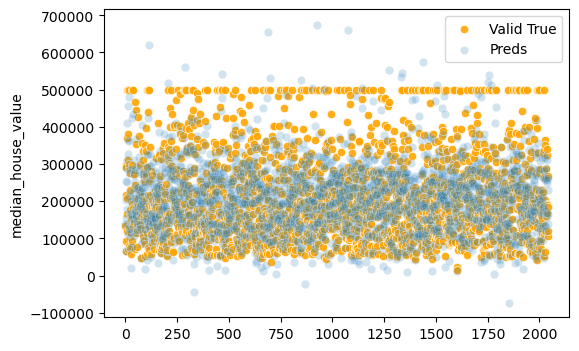

In [18]:
plt.figure(figsize=(6,4))

sns.scatterplot(x=range(0,len(linreg_model_001_001_valid_preds)), y=y_valid, color='orange', alpha=0.9, label="Valid True")
sns.scatterplot(x=range(0,len(linreg_model_001_001_valid_preds)), y=linreg_model_001_001_valid_preds, color="tab:blue", alpha=0.2, label="Preds")

plt.show()




* Validation data seems to be capped off at around 500,000 on the predictions

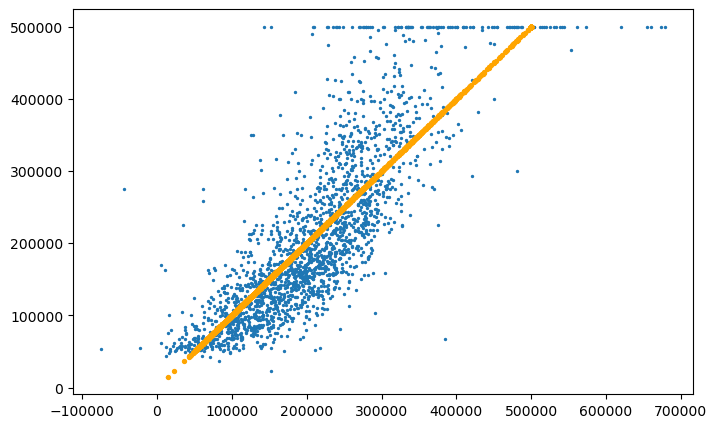

In [19]:
plt.figure(figsize=(8,5))

#plt.scatter(x=len(0,linreg_model_001_001_valid_preds), y=linreg_model_001_001_valid_preds)
#plt.scatter(x=linreg_model_001_001_valid_preds, y=linreg_model_001_001_valid_preds)
#plt.scatter(x=y_valid, y=y_valid)

plt.scatter(x=linreg_model_001_001_valid_preds, y=y_valid, s=8, marker='.', color="tab:blue")
plt.scatter(x=y_valid, y=y_valid, s=8, marker='o', color="orange")

plt.show()

Model predictions for Linear Regression seem to be following the true values (y_true)
There is a capped prediction outline trend pattern on the higher end of the spectrum

In [20]:
linreg_model_001_001_results_df = pd.DataFrame(data=[linreg_model_001_001.coef_], columns=[linreg_model_001_001.feature_names_in_]).transpose()
linreg_model_001_001_results_df



,0
longitude,-54313.16
latitude,-54812.66
housing_median_age,13615.99
total_rooms,-13815.25
total_bedrooms,43403.30
population,-41258.83
households,16493.03
median_income,74596.79
<1H OCEAN,-34269.44
INLAND,-73509.66


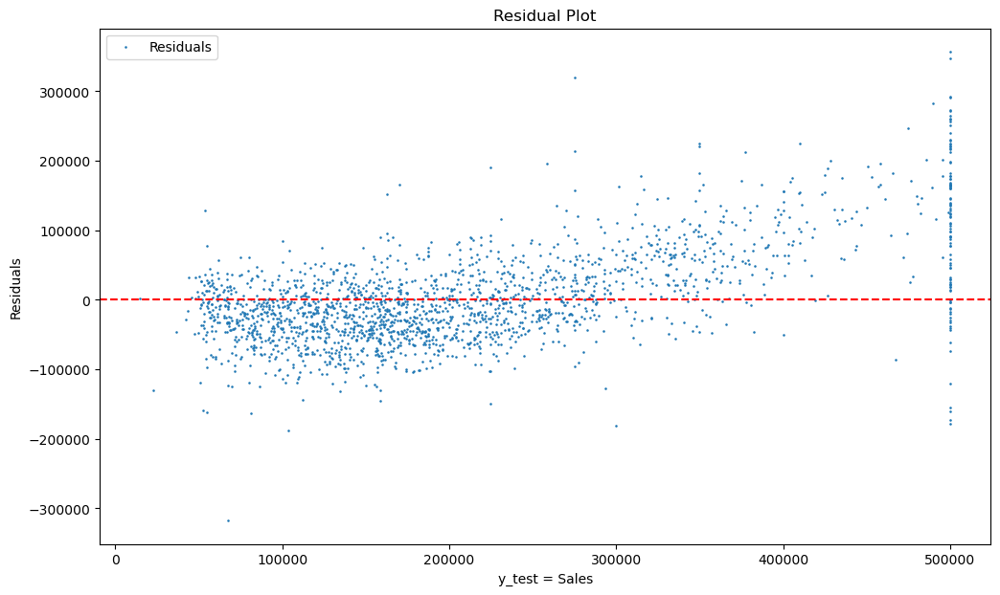

In [21]:
test_residuals_linreg_model_001_001 = y_valid - linreg_model_001_001_valid_preds

plt.figure(figsize=(12,7))

plt.scatter(x=y_valid, y=test_residuals_linreg_model_001_001, s=0.7, label='Residuals')
plt.axhline(y=0, xmin=0,color='r', ls='--')


plt.legend()
plt.xlabel("y_test = Sales")
plt.ylabel("Residuals")

plt.title("Residual Plot")

plt.show()



/var/folders/nv/07j2b68d6rv7fhnbrwpsj4840000gn/T/ipykernel_3973/631500679.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(a=test_residuals_linreg_model_001_001,


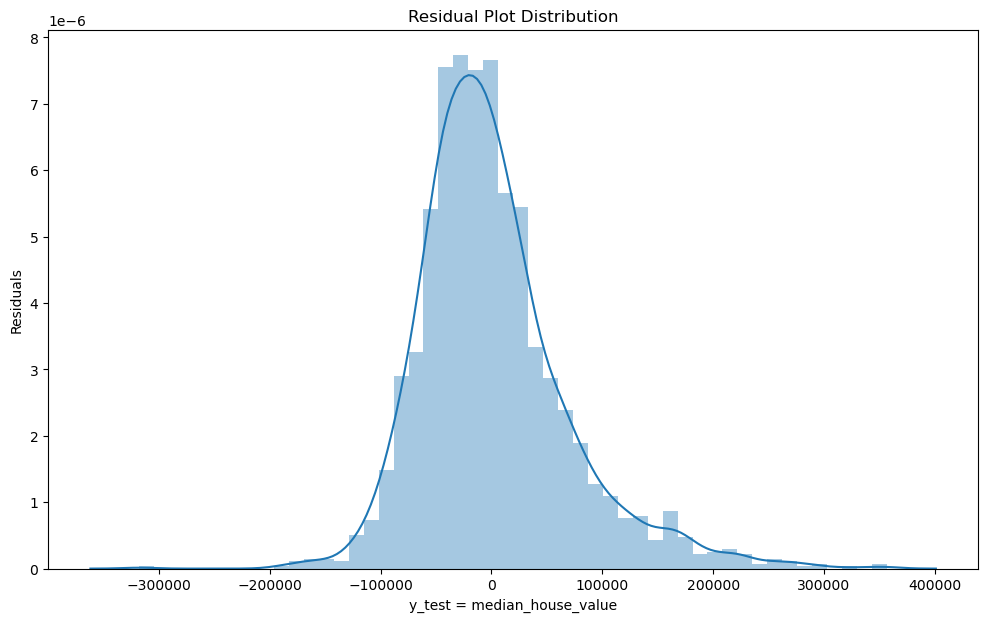

In [22]:

test_residuals_linreg_model_001_001 = y_valid - linreg_model_001_001_valid_preds
plt.figure(figsize=(12,7))

sns.distplot(a=test_residuals_linreg_model_001_001,
             bins=50,
             hist=True,
             kde=True,
             rug=False,
             fit=None,
             hist_kws=None,
             kde_kws=None,
             rug_kws=None,
             fit_kws=None,
             color=None,
             vertical=False,
             norm_hist=False,
             axlabel=None,
             label=None,
             ax=None,
             x=None)

plt.xlabel("y_test = median_house_value")
plt.ylabel("Residuals")

plt.title("Residual Plot Distribution")

plt.show()



* The majority of data seems to fit on as a Gaussian curve.
* There is right skewdness

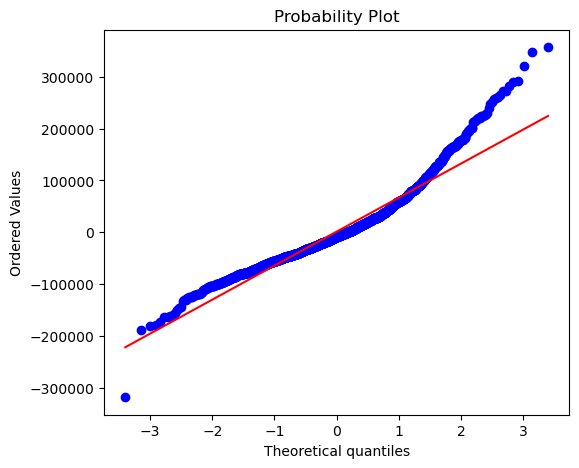

In [23]:
import scipy as sp

## Evaluating residuals
test_residuals_linreg_model_001_001 = y_valid - linreg_model_001_001_valid_preds

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(6,5), dpi=100)

## Probplot returns the raw values if needed
## We just want to see the plot, so we assign these values to _

_ = sp.stats.probplot(x=test_residuals_linreg_model_001_001,
                      sparams=(),
                      dist='norm',
                      fit=True,
                      plot=ax,## Default None
                      rvalue=False)

#plt.legend()

plt.title("Probability Plot")

plt.show()


- Capped values on the higher end of the spectrum of the residual plot seem to be deviating from the Normal Distribution.


##### Linear Regression does not entirely seem to be the best fit for this dataset

#### Polynomial Regression
Scaling: Yes
**Polynomial Regression**

Will use the Elbow method to see the optimal polynomial

In [12]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

elbow_method_poly_reg_train_mae_error = []
elbow_method_poly_reg_valid_mae_error = []

elbow_method_poly_reg_train_rmse_error = []
elbow_method_poly_reg_valid_rmse_error = []

for d in range(1,6):
    polynomial_converter_elbow_method = PolynomialFeatures(degree=d,
                                                           interaction_only=False,
                                                           include_bias=False,
                                                           order='C')
    
    poly_features_elbow_method = polynomial_converter_elbow_method.fit_transform(X02)

    
    X_train_poly, X_valid_tobe_poly, y_train_poly, y_valid_tobe_poly = train_test_split(poly_features_elbow_method,
                                                                                        y02, 
                                                                                        test_size=0.2,
                                                                                        random_state=42,
                                                                                        shuffle=True,
                                                                                        stratify=None)
    
    X_valid_poly, X_test_poly, y_valid_poly, y_test_poly = train_test_split(X_valid_tobe_poly,
                                                                            y_valid_tobe_poly, 
                                                                            test_size=0.5,
                                                                            random_state=42,
                                                                            shuffle=True,
                                                                            stratify=None)
    
    model_lin_reg_poly = LinearRegression(fit_intercept=True,
                                          copy_X=True,
                                          n_jobs=None,
                                          positive=False)
    model_lin_reg_poly.fit(X_train_poly, y_train_poly)
    
    pred_train_poly = model_lin_reg_poly.predict(X_train_poly)
    pred_valid_poly = model_lin_reg_poly.predict(X_valid_poly)
    
    train_mae_poly = mean_absolute_error(y_true=y_train_poly, 
                                          y_pred=pred_train_poly,
                                          sample_weight=None,
                                          multioutput='uniform_average')
    
    valid_mae_poly = mean_absolute_error(y_true=y_valid_poly,##
                                          y_pred=pred_valid_poly,##
                                          sample_weight=None,
                                          multioutput='uniform_average')
    
    train_rmse_poly = np.sqrt(mean_squared_error(y_true=y_train_poly,
                                         y_pred=pred_train_poly,
                                         sample_weight=None,
                                         multioutput='uniform_average',
                                         squared=True))
    
    valid_rmse_poly = np.sqrt(mean_squared_error(y_true=y_valid_poly,
                                         y_pred=pred_valid_poly,
                                         sample_weight=None,
                                         multioutput='uniform_average',
                                         squared=True))
    
    elbow_method_poly_reg_train_mae_error.append(train_mae_poly)
    elbow_method_poly_reg_valid_mae_error.append(valid_mae_poly)
    elbow_method_poly_reg_train_rmse_error.append(train_rmse_poly)
    elbow_method_poly_reg_valid_rmse_error.append(valid_rmse_poly)
    print(f"Ready: {d}")
    
    

Ready: 1
Ready: 2
Ready: 3
Ready: 4
Ready: 5


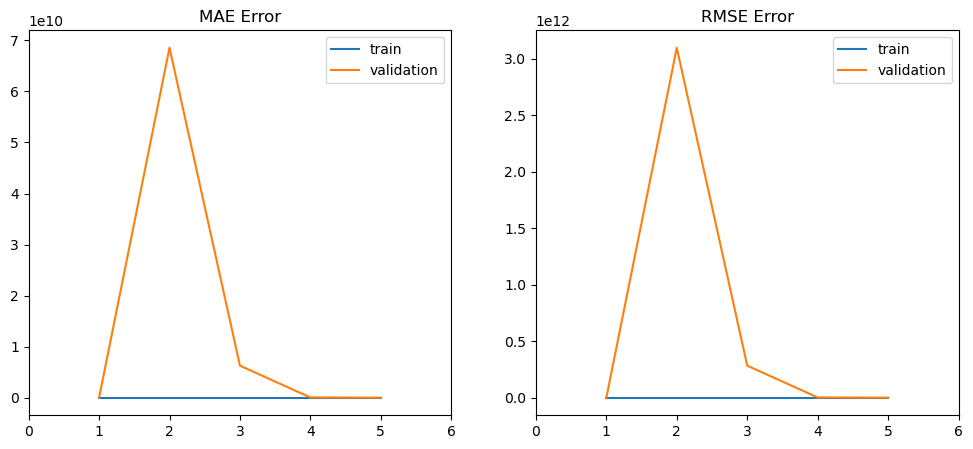

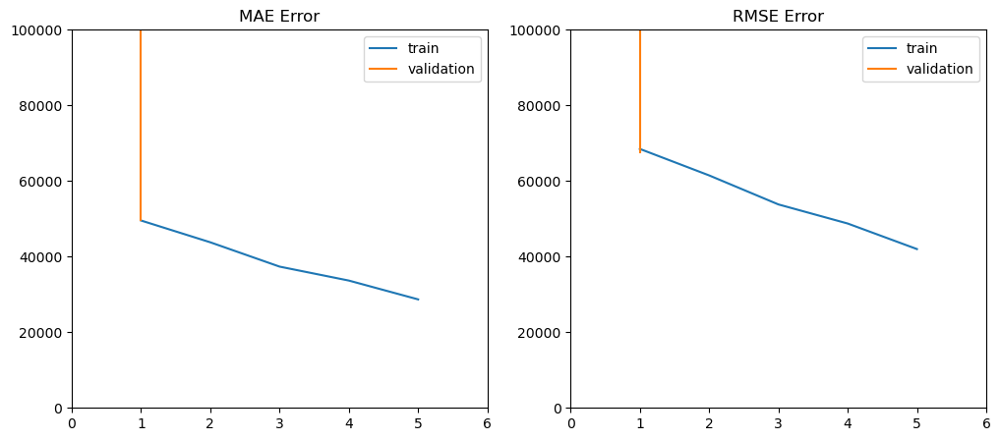

In [13]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12,5), dpi=100)

axes[0].plot(range(1,6), elbow_method_poly_reg_train_mae_error, label='train')
axes[0].plot(range(1,6), elbow_method_poly_reg_valid_mae_error, label='validation')

axes[1].plot(range(1,6), elbow_method_poly_reg_train_rmse_error, label='train')
axes[1].plot(range(1,6), elbow_method_poly_reg_valid_rmse_error, label='validation')

axes[0].set_xticks(range(0,7,1))
axes[1].set_xticks(range(0,7,1))


axes[0].set_title("MAE Error")
axes[1].set_title("RMSE Error")

axes[0].legend()
axes[1].legend()

plt.show()



fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12,5), dpi=100)

axes[0].plot(range(1,6), elbow_method_poly_reg_train_mae_error, label='train')
axes[0].plot(range(1,6), elbow_method_poly_reg_valid_mae_error, label='validation')
axes[1].plot(range(1,6), elbow_method_poly_reg_train_rmse_error, label='train')
axes[1].plot(range(1,6), elbow_method_poly_reg_valid_rmse_error, label='validation')

axes[0].set_xticks(range(0,7,1))
axes[1].set_xticks(range(0,7,1))

axes[0].set_ylim(0, 100000)
axes[1].set_ylim(0, 100000)

axes[0].set_title("MAE Error")
axes[1].set_title("RMSE Error")



axes[0].legend()
axes[1].legend()


plt.show()



In [14]:
## Polynomial degree 1

from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

poly_reg_train_mae_error_deg1 = []
poly_reg_valid_mae_error_deg1 = []
poly_reg_train_rmse_error_deg1 = []
poly_reg_valid_rmse_error_deg1 = []

poly_converter_deg1 = PolynomialFeatures(degree=1,
                                         interaction_only=False,
                                         include_bias=False,## Default = True
                                         order='C')

poly_features_deg1 = poly_converter_deg1.fit_transform(X02)

    

X_train_poly_deg1, X_valid_tobe_poly_deg1, y_train_poly_deg1, y_valid_tobe_poly_deg1 = train_test_split(poly_features_deg1,
                                                                                    y02, 
                                                                                    test_size=0.2,
                                                                                    random_state=42,
                                                                                    shuffle=True,
                                                                                    stratify=None)

X_valid_poly_deg1, X_test_poly_deg1, y_valid_poly_deg1, y_test_poly_deg1 = train_test_split(X_valid_tobe_poly_deg1,
                                                                        y_valid_tobe_poly_deg1, 
                                                                        test_size=0.5,
                                                                        random_state=42,
                                                                        shuffle=True,
                                                                        stratify=None)
    
model_lin_reg_poly_deg1 = LinearRegression(fit_intercept=True,
                                           copy_X=True,
                                           n_jobs=None,
                                           positive=False)

model_lin_reg_poly_deg1.fit(X_train_poly_deg1, y_train_poly_deg1)

pred_train_poly_deg1 = model_lin_reg_poly_deg1.predict(X_train_poly_deg1)
pred_valid_poly_deg1 = model_lin_reg_poly_deg1.predict(X_valid_poly_deg1)

train_mae_poly_deg1 = mean_absolute_error(y_true=y_train_poly_deg1, 
                                          y_pred=pred_train_poly_deg1,
                                          sample_weight=None,
                                          multioutput='uniform_average')
    
valid_mae_poly_deg1 = mean_absolute_error(y_true=y_valid_poly_deg1,##
                                          y_pred=pred_valid_poly_deg1,##
                                          sample_weight=None,
                                          multioutput='uniform_average')
    
train_rmse_poly_deg1 = np.sqrt(mean_squared_error(y_true=y_train_poly_deg1,
                                         y_pred=pred_train_poly_deg1,
                                         sample_weight=None,
                                         multioutput='uniform_average',
                                         squared=True))
    
valid_rmse_poly_deg1 = np.sqrt(mean_squared_error(y_true=y_valid_poly_deg1,
                                         y_pred=pred_valid_poly_deg1,
                                         sample_weight=None,
                                         multioutput='uniform_average',
                                         squared=True))
    
poly_reg_train_mae_error_deg1.append(train_mae_poly_deg1)
poly_reg_valid_mae_error_deg1.append(valid_mae_poly_deg1)
poly_reg_train_rmse_error_deg1.append(train_rmse_poly_deg1)
poly_reg_valid_rmse_error_deg1.append(valid_rmse_poly_deg1)

    

print(f"y_mean:{y.mean()}")

print(f"poly_reg_train_mae_error_deg1: {poly_reg_train_mae_error_deg1}")
print(f"poly_reg_valid_mae_error_deg1: {poly_reg_valid_mae_error_deg1}")
print(f"poly_reg_train_rmse_error_deg1: {poly_reg_train_rmse_error_deg1}")
print(f"poly_reg_valid_rmse_error_deg1: {poly_reg_valid_rmse_error_deg1}")

y_mean:206864.41315519012
poly_reg_train_mae_error_deg1: [49549.965899364506]
poly_reg_valid_mae_error_deg1: [49564.9322051044]
poly_reg_train_rmse_error_deg1: [68487.30666948423]
poly_reg_valid_rmse_error_deg1: [67706.03188712957]


#### Regularization Techniques
Scaling: Yes
L1 Regularization - LASSO
L2 Regularization - Ridge
**Elastic Net L1 L2**

In [15]:
## Elastic Net
from sklearn.linear_model import ElasticNet
from sklearn.model_selection import GridSearchCV

elasticnet_model_001_001 = ElasticNet(alpha=1.0,
                                      l1_ratio=0.5,
                                      fit_intercept=True,
                                      precompute=False,
                                      max_iter=5000,## Default 1000
                                      copy_X=True,
                                      tol=0.0001,
                                      warm_start=False,
                                      positive=False,
                                      random_state=42,## Default None
                                      selection='cyclic')


alpha = [0.1, 0.5, 1, 5, 10, 50, 100]
l1_ratio = [0.1, 0.5, .7, .9, .95, 1]

param_grid = {'alpha':alpha,
              'l1_ratio':l1_ratio}

## Grid Search CV
grid_elasticnet_model_001_001 = GridSearchCV(estimator=elasticnet_model_001_001,
                                             param_grid=param_grid,
                                             scoring='neg_mean_squared_error',## Default None
                                             n_jobs=None,
                                             refit=True,
                                             cv=None,## None = 5 K folds
                                             verbose=1,## Default 0
                                             pre_dispatch='2*n_jobs',
                                             return_train_score=False,)


grid_elasticnet_model_001_001.fit(X_train, y_train)

elasticnet_model_001_001_valid_preds = grid_elasticnet_model_001_001.predict(X_valid)

model_stats(model=grid_elasticnet_model_001_001, model_used=ElasticNet, model_name=elasticnet_model_001_001, param_grid_used=False)

mae_score_elasticnet_model_001_001_val = []
rmse_score_elasticnet_model_001_001_val = []
explained_var_score_elasticnet_model_001_001_val = []
r2_score_elasticnet_model_001_001_val = []

show_model_metrics_regression(model=grid_elasticnet_model_001_001, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_elasticnet_model_001_001_val,
                                  rmse_score_list=rmse_score_elasticnet_model_001_001_val,
                                  explained_var_score_list=explained_var_score_elasticnet_model_001_001_val,
                                  r2_score_list=r2_score_elasticnet_model_001_001_val)



Fitting 5 folds for each of 42 candidates, totalling 210 fits


/Users/luis/miniforge3/envs/venv_0261_DS_Projects_311/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.140e+12, tolerance: 1.749e+10
  model = cd_fast.enet_coordinate_descent(
/Users/luis/miniforge3/envs/venv_0261_DS_Projects_311/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.974e+12, tolerance: 1.749e+10
  model = cd_fast.enet_coordinate_descent(
/Users/luis/miniforge3/envs/venv_0261_DS_Projects_311/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the numbe

Model: <class 'sklearn.linear_model._coordinate_descent.ElasticNet'>
 Model Object Variable Name: ElasticNet(max_iter=5000, random_state=42)
Trained Model Variable Name: GridSearchCV(estimator=ElasticNet(max_iter=5000, random_state=42),
             param_grid={'alpha': [0.1, 0.5, 1, 5, 10, 50, 100],
                         'l1_ratio': [0.1, 0.5, 0.7, 0.9, 0.95, 1]},
             scoring='neg_mean_squared_error', verbose=1)


  Median of y: 179700.0
y_test Median: 182000.0


  Mean of y: 206864.41315519012
y_test Mean: 209672.04796867352


 MAE: 49551.93502135185  -> 49551.9350
RMSE: 67672.26049668764 -> 67672.2605
R2 Coefficient of Determination: 0.6628283615662859 -> 0.6628


Model RMSE is 67672.2605 and that is on the 32.713341 % error range
explained_var_score: 0.6629991098157428




In [16]:
## Elastic Net
from sklearn.linear_model import ElasticNet
from sklearn.model_selection import GridSearchCV

elasticnet_model_001_002 = ElasticNet(alpha=1.0,
                                      l1_ratio=0.5,
                                      fit_intercept=True,
                                      precompute=False,
                                      max_iter=5000,## Default 1000
                                      copy_X=True,
                                      tol=0.0001,
                                      warm_start=False,
                                      positive=False,
                                      random_state=42,## Default None
                                      selection='cyclic')

## Param Grid 002


alpha = [0.1, 0.5, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 50]
l1_ratio = [0.1, 0.5, .7, .9, .95, .96, .97, .98, .99, 1]


param_grid = {'alpha':alpha,
              'l1_ratio':l1_ratio}

## Grid Search CV
grid_elasticnet_model_001_002 = GridSearchCV(estimator=elasticnet_model_001_002,
                                             param_grid=param_grid,
                                             scoring='neg_mean_squared_error',
                                             n_jobs=None,
                                             refit=True,
                                             cv=None,
                                             verbose=1,
                                             pre_dispatch='2*n_jobs',
                                             return_train_score=False,)

grid_elasticnet_model_001_002.fit(X_train, y_train)

elasticnet_model_001_002_valid_preds = grid_elasticnet_model_001_002.predict(X_valid)



Fitting 5 folds for each of 130 candidates, totalling 650 fits


/Users/luis/miniforge3/envs/venv_0261_DS_Projects_311/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.140e+12, tolerance: 1.749e+10
  model = cd_fast.enet_coordinate_descent(
/Users/luis/miniforge3/envs/venv_0261_DS_Projects_311/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.974e+12, tolerance: 1.749e+10
  model = cd_fast.enet_coordinate_descent(
/Users/luis/miniforge3/envs/venv_0261_DS_Projects_311/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the numbe

In [17]:
## Elastic Net
##linreg_model_001_002
##linreg_model_001_002_preds
model_stats(model=grid_elasticnet_model_001_002, model_used=ElasticNet, model_name=elasticnet_model_001_002, param_grid_used=False)

mae_score_elasticnet_model_001_002_val = []
rmse_score_elasticnet_model_001_002_val = []
explained_var_score_elasticnet_model_001_002_val = []
r2_score_elasticnet_model_001_002_val = []

show_model_metrics_regression(model=grid_elasticnet_model_001_002, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_elasticnet_model_001_002_val,
                                  rmse_score_list=rmse_score_elasticnet_model_001_002_val,
                                  explained_var_score_list=explained_var_score_elasticnet_model_001_002_val,
                                  r2_score_list=r2_score_elasticnet_model_001_002_val)


Model: <class 'sklearn.linear_model._coordinate_descent.ElasticNet'>
 Model Object Variable Name: ElasticNet(max_iter=5000, random_state=42)
Trained Model Variable Name: GridSearchCV(estimator=ElasticNet(max_iter=5000, random_state=42),
             param_grid={'alpha': [0.1, 0.5, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 50],
                         'l1_ratio': [0.1, 0.5, 0.7, 0.9, 0.95, 0.96, 0.97,
                                      0.98, 0.99, 1]},
             scoring='neg_mean_squared_error', verbose=1)


  Median of y: 179700.0
y_test Median: 182000.0


  Mean of y: 206864.41315519012
y_test Mean: 209672.04796867352


 MAE: 49557.13332102286  -> 49557.1333
RMSE: 67685.12328588415 -> 67685.1233
R2 Coefficient of Determination: 0.662700173743079 -> 0.6627


Model RMSE is 67685.1233 and that is on the 32.719559 % error range
explained_var_score: 0.6628700911479017




In [18]:
## Elastic Net
from sklearn.linear_model import ElasticNet
from sklearn.model_selection import GridSearchCV

elasticnet_model_001_003 = ElasticNet(alpha=1.0,
                                      l1_ratio=0.5,
                                      fit_intercept=True,
                                      precompute=False,
                                      max_iter=5000,
                                      copy_X=True,
                                      tol=0.0001,
                                      warm_start=False,
                                      positive=False,
                                      random_state=42,
                                      selection='cyclic')



alpha = [0.1, 0.5, 1, 2, 2.5, 3, 3.5, 4, 5, 6, 10]
l1_ratio = [0.1, .9, .95, .96, .97, .98, .99, 1]

param_grid = {'alpha':alpha,
              'l1_ratio':l1_ratio}

grid_elasticnet_model_001_003 = GridSearchCV(estimator=elasticnet_model_001_003,
                                             param_grid=param_grid,
                                             scoring='neg_mean_squared_error',
                                             n_jobs=None,
                                             refit=True,
                                             cv=None,
                                             verbose=1,
                                             pre_dispatch='2*n_jobs',
                                             return_train_score=False,)

grid_elasticnet_model_001_003.fit(X_train, y_train)

elasticnet_model_001_003_valid_preds = grid_elasticnet_model_001_003.predict(X_valid)


Fitting 5 folds for each of 88 candidates, totalling 440 fits


/Users/luis/miniforge3/envs/venv_0261_DS_Projects_311/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.140e+12, tolerance: 1.749e+10
  model = cd_fast.enet_coordinate_descent(
/Users/luis/miniforge3/envs/venv_0261_DS_Projects_311/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.974e+12, tolerance: 1.749e+10
  model = cd_fast.enet_coordinate_descent(
/Users/luis/miniforge3/envs/venv_0261_DS_Projects_311/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the numbe

In [19]:
## Elastic Net
##linreg_model_001_003

model_stats(model=grid_elasticnet_model_001_003, model_used=ElasticNet, model_name=elasticnet_model_001_003, param_grid_used=False)

mae_score_elasticnet_model_001_003_val = []
rmse_score_elasticnet_model_001_003_val = []
explained_var_score_elasticnet_model_001_003_val = []
r2_score_elasticnet_model_001_003_val = []

show_model_metrics_regression(model=grid_elasticnet_model_001_003, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_elasticnet_model_001_003_val,
                                  rmse_score_list=rmse_score_elasticnet_model_001_003_val,
                                  explained_var_score_list=explained_var_score_elasticnet_model_001_003_val,
                                  r2_score_list=r2_score_elasticnet_model_001_003_val)



Model: <class 'sklearn.linear_model._coordinate_descent.ElasticNet'>
 Model Object Variable Name: ElasticNet(max_iter=5000, random_state=42)
Trained Model Variable Name: GridSearchCV(estimator=ElasticNet(max_iter=5000, random_state=42),
             param_grid={'alpha': [0.1, 0.5, 1, 2, 2.5, 3, 3.5, 4, 5, 6, 10],
                         'l1_ratio': [0.1, 0.9, 0.95, 0.96, 0.97, 0.98, 0.99,
                                      1]},
             scoring='neg_mean_squared_error', verbose=1)


  Median of y: 179700.0
y_test Median: 182000.0


  Mean of y: 206864.41315519012
y_test Mean: 209672.04796867352


 MAE: 49555.83305722182  -> 49555.8331
RMSE: 67681.8269674355 -> 67681.8270
R2 Coefficient of Determination: 0.6627330264738451 -> 0.6627


Model RMSE is 67681.8270 and that is on the 32.717965 % error range
explained_var_score: 0.6629031517057042




#### Logistic Regression
Scaling: Yes
**Logistic Regression**

In [20]:
##Logistic Regression Grid Search

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV

logreg_model_001_001 = LogisticRegression(penalty='elasticnet',
                                       dual=False,
                                       tol=0.01,
                                       C=1.0,
                                       fit_intercept=True,
                                       intercept_scaling=1,
                                       class_weight=None,
                                       random_state=None,
                                       solver='saga',
                                       max_iter=500,
                                       multi_class='ovr',
                                       verbose=3,
                                       warm_start=False,
                                       n_jobs=None,
                                       l1_ratio=None)

l1_ratio = np.linspace(0,1,5)
C = np.logspace(0, 10, 5)

param_grid = {'l1_ratio':l1_ratio,
              'C': C}

grid_logreg_model_001_001 = GridSearchCV(estimator=logreg_model_001_001,
                                  param_grid=param_grid,
                                  scoring=None,
                                  n_jobs=None,
                                  refit=True,
                                  cv=None,
                                  verbose=4,
                                  pre_dispatch='2*n_jobs',
                                  return_train_score=False)

grid_logreg_model_001_001.fit(X_train, y_train)


Fitting 5 folds for each of 25 candidates, totalling 125 fits
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds


/Users/luis/miniforge3/envs/venv_0261_DS_Projects_311/lib/python3.11/site-packages/sklearn/model_selection/_split.py:725: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.4s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08397468
Epoch 3, change: 0.03748754
Epoch 4, change: 0.02502084
Epoch 5, change: 0.02098785
Epoch 6, change: 0.01545209
Epoch 7, change: 0.01455392
Epoch 8, change: 0.01223181
Epoch 9, change: 0.01104496
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08538948
Epoch 3, change: 0.03994675
Epoch 4, change: 0.

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    1.6s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    3.7s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    6.7s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
.01020751
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09151508
Epoch 3, change: 0.03873628
Epoch 4, change: 0.02899357
Epoch 5, change: 0.02216548
Epoch 6, change: 0.01777408
Epoch 7, change: 0.01591502
Epoch 8, change: 0.01404714
Epoch 9, change: 0.01240879
Epoch 10, change: 0.01113194
Epoch 11, change: 0.01005737
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08554753
Epoch 3, change: 0.03940789
Epoch 4, change: 0.02463307
Epoch 5, change: 0.02072610
Epoch 6, change: 0.01739062
Epoch 7, change: 0.01505120
Epoch 8, change: 0.01226552
Epoch 9, change: 0.0111755

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   10.4s


convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
 9, change: 0.01162057
Epoch 10, change: 0.01039446
Ep

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   15.0s


convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 23 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence 

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   20.2s


convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   26.2s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   33.2s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   41.1s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
h 4, change: 0.02825316
Epoch 5, change: 0.02163072
Epoch 6, change: 0.01802315
Epoch 7, change: 0.01510882
Epoch 8, change: 0.01337715
Epoch 9, change: 0.01190919
Epoch 10, change: 0.01064279
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08601899
Epoch 3, change: 0.03784466
Epoch 4, change: 0.02611008
Epoch 5, change: 0.02157722
Epoch 6, change: 0.01745200
Epoch 7, change: 0.01451816
Epoch 8, 

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.4s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    1.6s


convergence after 11 epochs took 0 seconds
 0.02689730
Epoch 5, change: 0.01980914
Epoch 6, change: 0.01693930
Epoch 7, change: 0.01514621
Epoch 8, change: 0.01325274
Epoch 9, change: 0.01155162
Epoch 10, change: 0.01038293
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08333395
Epoch 3, change: 0.03939279
Epoch 4, change: 0.02636037
Epoch 5, change: 0.02136385
Epoch 6, change: 0.01820327
Epoch 7, change: 0.01526447
Epoch 8, change: 0.01351115
Epoch 9, change: 0.01204005
Epoch 10, change: 0.01069902
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09071490
Epoch 3, change: 0.03689323
Epoch 4, change: 0.02673926
Epoch 5, change: 0.02166215
Epoch 6, change: 0.01886024
Epoch 7, change: 0.01556028
Epoch 8, change: 0.01323821
Epoch 9, change: 0.01201608
Epoch 10, change: 0.01077557
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08421229
Epoch 3, change: 0.03758738
Epoch 4, change: 0.02535679
Epoch 5, change: 0.01870569
Epoch 6, change: 0.01636257
Epoch 7, change: 0.01441655
Epoch 8, change: 0

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    3.7s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
 9, change: 0.01176487
Epoch 10, change: 0.01043097
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08796719
Epoch 3, change: 0.03958654
Epoch 4, change: 0.02608209
Epoch 5, change: 0.02003196
Epoch 6, change: 0.01818484
Epoch 7, change: 0.01468465
Epoch 8, change: 0.01330982
Epoch 9, change: 0.01127078
Epoch 10

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    6.6s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   10.1s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence 

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   14.5s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence a

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   19.7s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   26.0s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   33.1s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   40.9s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
 change: 0.02127614
Epoch 6, change: 0.01766496
Epoch 7, change: 0.01557292
Epoch 8, change: 0.01347476
Epoch 9, change: 0.01211432
Epoch 10, change: 0.01084999
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08354205
Epoch 3, change: 0.03628433
Epoch 4, change: 0.02579047
Epoch 5, change: 0.02077998
Epoch 6, change: 0.01735113
Epoch 7, change: 0.0151260

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.4s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    1.7s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    3.7s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
Epoch 9, change: 0.01111342
Epoch 10, change: 0.01000240
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09037275
Epoch 3, change: 0.04142540
Epoch 4, change: 0.02560981
Epoch 5, change: 0.01987039
Epoch 6, change: 0.01570951
Epoch 7, change: 0.01469278
Epoch 8, change: 0.01289750
Epoch 9, change: 0.01143336
Epoch 10, change: 0.01019681
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07947927
Epoch 3, change: 0.03822487
Epoch 4, change: 0.02545236
Epoch 5, change: 0.02131612
Epoch 6, change: 0.01753240
Epoch 7, change: 0.01522509
Epoch 8, change: 0.01314448
Epoch 9, change: 0.01177807
Epoch 10, change: 0.01052435
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08894999
Epoch 3, change: 0.03545

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    6.5s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
 0.04302109
Epoch 4, change: 0.02899248
Epoch 5, change: 0.02162367
Epoch 6, change: 0.01790392
Epoch 7, change: 0.01498304
Epoch 8, change: 0.01300789
Epoch 9, change: 0.01150181
Epoch 10, change: 0.01037712
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08998099
Epoch 3, change: 0.03861141
Epoch 4, change: 0.02554959
Epoch 5, change: 0.02066917
Epoch 6, change: 0.01577130
Epoch 7, change: 0.01380540
Epoch 8, change: 0.01163581
Epoch 9, change: 0.01052099
Epoch 1, change: 1.0000

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   10.0s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   14.3s


convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 23 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence a

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   19.3s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   25.3s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   32.0s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   39.5s


convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
.00000000
Epoch 2, change: 0.08986425
Epoch 3, change: 0.03967926
Epoch 4, change: 0.03003286
Epoch 5, change: 0.02048393
Epoch 6, change: 0.01597448
Epoch 7, change: 0.01455766
Epoch 8, change: 0.01288157
Epoch 9, change: 0.01140447
Epoch 10, change: 0.01003477
Epoch 

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.3s


convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    1.3s


convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
ch 5, change: 0.01683383
Epoch 6

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    2.9s


convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
 7, change: 0.01263126
Epoch 8, change: 0.01139645
Epoch 9, change: 0.01022501
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07322497
Epoch 3, change: 0.03228307
Epoch 4, change: 0.02295018
Epoch 5, change: 0.01834513
Epoch 6, change: 0.01432580
Epoch 7, change: 0.01217162
Epoch 8, change: 0.01114704
Epoch 1, change: 1.00000000
Epoch 2, change: 0.06946278
Epoch 3, change: 0.02646679
Epoch 4, change: 0.01914972
Epoch 5, change: 0.01524112
Epoch 6, change: 0.01372783
Epoch 7, change: 0.011808

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    5.2s


convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
poch 7, change: 0.01143618
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07142691
Epoch 3, change: 0.02568863
Epoch 4, change: 0.01842910
Epoch 5, change: 0.01523760
Epoch 6, change: 0.01358000
Epoch 7, change: 0.01131892
Epoch 8, change: 0.01015182
Epoch 1, change: 1.00000000
Epoch 2, change: 0.06867831
Epoch 3, change: 0.02954360
Epoch 4, change: 0.01992750
Epoch 

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:    8.1s


convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   11.6s


convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 23 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 1 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs too

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   15.9s


convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
change: 1.00000000
Epoch 2, change: 0.06211652
Epoch 3, change: 0.02649650
Epoch 4, change: 0.02050953
Epoch 5, change: 0.01684406
Epoch 6, change: 0.01467006
Epoch 7, change: 0.01302135
Epoch 8, change: 0.01116488
Epoch 9, change: 0.01012314
Epoch 1, change: 1.00000000
Epoch 2, change: 0.06098627
Epoch 3, change: 0.03029742
Epoch 4, change: 0.01974703
Epoch 5, change: 0.01574341
Epoch 6, change: 0.01346184
Epoch 7, change: 0.01180481
Epoch 8, change: 0.01054867
Epoch 1, change: 1.00000000


[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   20.8s


convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs t

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   26.4s


convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   32.7s


convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 1 seconds
e: 0.02002451
Epoch 5, change: 0.01707464
Epoch 6, change: 0.01345833
Epoch 7, change: 0.01194840
Epoch 8, change: 0.01053471
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07405270
Epoch 3, change: 0.03163701
Epoch 4, change: 0.02217285
Epoch

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.4s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    1.6s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    3.6s


convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
 change: 0.02733884
Epoch 5, change: 0.02315271
Epoch 6, change: 0.01808348
Epoch 7, change: 0.01562832
Epoch 8, change: 0.01355963
Epoch 9, change: 0.01214119
Epoch 10, change: 0.01083537
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08383714
Epoch 3, change: 0.03892821
Epoch 4, change: 0.02404535
Epoch 5, change: 0.02117505
Epoch 6, change: 0.01760905
Epoch 7, change: 0.01483705
Epoch 8, change: 0.01319110
Epoch 9, change: 0.01145077
Epoch 10, change: 0.01038271
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08602750
Epoch 3, change: 0.03912966
Epoch 4, change: 0.02757430
Epoch 5, change: 0.02200038
Epoch 6, change: 0.01924694
Epoch 7, change: 0

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    6.4s


convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
ge: 0.02780994
Epoch 5, change: 0.02028103
Epoch 6, ch

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:    9.9s


convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 1 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence 

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   14.1s


convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 24 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence af

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   19.2s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   25.1s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   31.8s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   39.3s


convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
 change: 0.01370829
Epoch 9, change: 0.01225289
Epoch 10, change: 0.01078506
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08561813
Epoch 3, change: 0.03994163
Epoch 4, change: 0.02615337
Epoch 5, change: 0.02102232
Epoch 6, change: 0.01759706
Epoch 7, change: 0.01514892
Epoch 8, change: 0.01350766
Epoch 9, change: 0.01192096
Epoch 10, change: 0.01062074
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09109274
Epoch 3, change: 0.04069569
Epoch 4, change: 0.02701168
Epoch 5, change: 0.02234786
Epoch 6, change: 0.01599507
Epoch 7, change: 0.01475913
Epoch 8, change: 0.01279107
Epoch 9, change: 0.01130437
Epoch 10, change: 0.01008067
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07984045
Epoch 3, change: 0.03751985
Epoch 4, change: 0.02624087
Epoch 5, change: 0.01994306
Epoch 

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.5s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
och 1, change: 1.00000000
Epoch 2, change: 0.08891700
Epoch 3, change: 0.03430777
Epoch 4, change: 0.02608938
Epoch 5, change: 0.02112674
Epoch 6, change: 0.01819387
Epoch 7, change: 0.01463834
Epoch 8, change: 0.01312329
Epoch 9, change: 0.01169346
Epoch 10, change: 0

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    1.9s


convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.4s


convergence after 11 epochs took 0 seconds
0.01101148
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08127996
Epoch 3, change: 0.03780680
Epoch 4, change: 0.02835519
Epoch 5, change: 0.02078719
Epoch 6, change: 0.01848226
Epoch 7, change: 0.01546690
Epoch 8, change: 0.01383776
Epoch 9, change: 0.01205128
Epoch 10, change: 0.01087020
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08776321
Epoch 3, change: 0.03536906
Epoch 4, change: 0.02557085
Epoch 5, change: 0.02163305
Epoch 6, change: 0.01876665
Epoch 7, change: 0.01537025
Epoch 8, change: 0.01381553
Epoch 9, change: 0.01239078
Epoch 10, change: 0.01052257
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08342162
Epoch 3, change: 0.03817825
Epoch 4, change: 0.02491285
Epoch 5, change: 0.02282417
Epoch 6, change: 0.01901998
Epoch 7, change: 0.01599880
Epoch 8, change: 0.01338835
Epoch 9, change: 0.01209041
Epoch 10, change: 0.01089142
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08984457
Epoch 3, change: 0.04218412
Epoch 4, change: 0.

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    7.8s


convergence after 10 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
, change: 0.02601301
Epoch 5, change: 0.01831281
Epoch 6, change: 0.01724049
Epoch 7, change: 0.01457724
Epoch 8, change: 0.01269770
Epoch 9, change: 0.01121635
Epoch 10, change: 0.01000801
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08799444
Epoch 3, change: 0.03957365
Epoch 4, change: 0.02921290
Epoch 5, change: 0.02191555
Epoch 6, change: 0.01924204
Epoch 7, change: 0.01662206
Epoch 8, change: 0.01403899
Epoch 9, change: 0.01233251
Epoch 10, change: 0.01118676
Epoch 11, cha

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   12.1s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
01253172
Epoch 9, change: 0.01104651
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08634355
Epoch 3, change: 0.03982766
Epoch 4, change: 0.

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   17.4s


convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence a

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   23.7s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   30.9s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
e: 0.04134659
Epoch 4, change: 0.02825196
Epoch 5, change: 0.02286419
Epoch 6, change: 0.01881125

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   39.2s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
2805479
Epoch 5, change: 0.02108863
Epoch 6, change: 0.01778193
Epoch 7, change: 0.01513779
Epoch 8, change: 0.01276889
Epoch 9, change: 0.01112206
Epoch 10, change: 0.01012667
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08008033
Epoch 3, change: 0.04013618
Epoch 4, change: 0.02626053
Epoch 5, change: 0.02081369
Epoch 6, change: 0.01664727
Epoch 7, change: 0.01463989
Epoch 8, change: 0.01275862
Epoch 9, change: 0.01139069
Epoch 10, change: 0.01025878
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09073058
Epoch 3, change: 0.04044774
Epoch 4, change: 0.02535480


[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   48.4s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.5s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
, change: 0.02695496
Epoch 5, change: 0.02006761
Epoch 6, change: 0.01720352
Epoch 7, change: 0.01435865
Epoch 8, change: 0.01300657
Epoch 9, change: 0.01135619
Epoch 10, change: 0.01024987
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08434438
Epoch 3, change: 0.03587676
Epoch 4, change: 0.02474664
Epoch 5, change: 0.01912033
Epoch 6, change: 0.016963

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    1.9s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.4s


convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    7.8s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   12.1s


convergence after 8 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
e: 0.01366705
Epoch 9, change: 0.01218747
Epoch 10, change: 0.01084107
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08032947
Epoch 3, change: 0.03712530
Epoch 4, change: 0.02430814
Epoch 5, change: 0.02011573
Epoch 6, change: 0.01680942
Epoch 7, change: 0.01445187
Epoch 8, change: 0.01264480
Epoch 9, change: 0.01142058
Epoch 10, change: 0.01025997
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08783813
Epoch 3, change: 0.04057761
Epoch 4, change: 0.02384531
Epoch 5, change: 0.02072415
Epoch 6, change: 0.01653468
Epoch 7, change: 0.01438168
Epoch 8, change: 0.01241080
Epoch 9, change: 0.01116900
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08797519
Epoch 3, change: 0.03602498
Epoch 4, change: 0.02635781
Epoch 5, change: 0.02150202
Epoch 6, change: 0.01787032
Epoch 7, change: 0.01545566
Epoch 8, change: 0.01345135
Epoch 9, change: 0.01172525
Epoch 10, change: 0.01038301
Epoch 1, change: 1.00000000
Ep

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   17.4s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
0.01309924
Epoch 8, change: 0.01166762
Epoch 9, change: 0.01039744
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08408254
Epoch 3, change: 0.03723355
Epoch 4, change: 0.02402901
Epoch 5, change: 0.01921276
Epoch 6, change: 0.01683866
Epoch 7, change: 0.01474686
Epoch 8, change: 0.01279140
Epoch 9, change: 0.01138019
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08358285
Epoch 3, change: 0.03639

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   23.6s


convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
00
Epoch 2, change: 0.08375508
Epoch 3, change: 0.03981929
Epoch 4, change: 0.02711813
Epoch 5, change: 0.02026249
Epoch 6, change: 0.01621363
Epoch 7, change: 0.01474125
Epoch 8, change: 0.01268610
Epoch 9, change: 0.01127784
Epoch 10, change: 0.01019694
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08012959
Epoch 3, change: 0.04272150
Epoch 4, change: 0.02741660
Epoch 5, change: 0.02172368
Epoch 6, change: 0.01854257
Epoch 7, change: 0.01609591
Epoch 8, change: 0.01327843
Epoc

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   30.8s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   39.1s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   48.3s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.5s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    2.0s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.5s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
 2, change: 0.08445623
Epoch 3, change: 0.04000676
Epoch 4, change: 0.02562630
Epoch 5, change: 0.02033334
Epoch 6, change: 0.01788612
Epoch 7, change: 0.01565464
Epoch 8, change: 0.01335905
Epoch 9, change: 0.01203685
Epoch 10, change: 0.01069153
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09509710
Epoch 3, change: 0.04234845
Epoch 4, change: 0.02669035
Epoch 5, change: 0.02089303
Epoch 6, c

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    8.0s


convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds

Epoch 2, c

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   12.4s


convergence after 8 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 1 seconds
convergence 

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   17.6s


convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 23 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence a

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   24.0s


convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   31.3s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   39.6s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
Epoch 3, change: 0.03601520
Epoch 4, change: 0.0255011

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   48.9s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.4s


convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
432
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08684989
Epoch 3, change: 0.04007870
Epoch 4, change: 0.02846499

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    1.6s


convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs too

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    3.7s


convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    6.5s


convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 7 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   10.1s


convergence after 8 epochs took 0 seconds
convergence after 7 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 7 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   14.4s


convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 22 epochs too

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   19.7s


convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs to

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   26.0s


convergence after 9 epochs took 0 seconds
503965
Epoch 6, change: 0.01193489
Epoch 7, change: 0.01098700
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07085361
Epoch 3, change: 0.03051516
Epoch 4, change: 0.02188931
Epoch 5, change: 0.01487404
Epoch 6, change: 0.01450269
Epoch 7, change: 0.01260043
Epoch 8, change: 0.01107832
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07210880
Epoch 3, change: 0.02851774
Epoch 4, change: 0.01954744
Epoch 5, change: 0.01688933
Epoch 6, change: 0.01325744
Epoch 7, change: 0.01223423
Epoch 8, change: 0.01092066
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07101645
Epoch 3, change: 0.02841426
Epoch 4, change: 0.02011016
Epoch 5, change: 0.01770034
Epoch 6, change: 0.01467664
Epoch 7, change: 0.01165983
Epoch 8, change: 0.01060154
Epoch 1, change: 1.00000000
Epoch 2, change: 0.06511407
Epoch 3, change: 0.03297645
Epoch 4, change: 0.01838314
Epoch 5, change: 0.01590961
Epoch 6, change: 0.01337725
Epoch 7, change: 0.01133366
Epoch 8, change: 0.01015986

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   33.0s


convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 1 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   40.8s


convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
h 5, change: 0.01723727
Epoch 6, change: 0.01350284
Epoch 7, change: 0.01070275
Epoch 1, change: 1.00000000
Epoch 2, change: 0.06858213
Epoch 3, change: 0.03293125
Epoch 4, change: 0.02123385
Epoch 5, change: 0.01650115
Epoch 6, change: 0.01427216
Epoch 7, change: 0.01174575
Epoch 8, c

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.5s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    2.0s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.4s


convergence after 11 epochs took 1 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
122
Epoch 8, change: 0.01385102
Epoch 9, change: 0.01228832
Epoch 10, change: 0.01097676
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08147459
Epoch 3, change: 0.04217758
Epoch 4, change: 0.02916834
Epoch 5, change: 0.02226271
Epoch 6, change: 0.01847016
Epoch 7, change: 0.01631691
Epoch 8, change: 0.01421114
Epoch 9, change: 0.01222153
Epoch 10, change: 0.01098706
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08586571
Epoch 3, change: 0.03662510
Epoch 4, change: 0.02523457
Epoch 5, change: 0.02036617
Epoch 6, change: 0.01703788
Epoch 7, change: 0.01466045
Epoch 8, change: 0.01296158
Epoch 9, change: 0.01150298
Epoch 10, change: 0.01027483
Epoch

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    7.9s


convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
ange: 0.011

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   12.2s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   17.5s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 1 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence 

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   23.7s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   31.1s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   39.3s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
poch 2, change: 0.08585228
Epoch 3, change: 0.03951021
Epoch 4, change: 0.02404677
Epoch 5, change: 0.02001871
Epoch 6, change: 0.01627404
Epoch 7, change: 0.01467365
Epoch 8, change: 0.01272945
Epoch 9, change: 0.01127006
Epoch 10, change: 0.01014193
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08877692
Epoch 3, change: 0.03700824
Epoch 4, change: 0.02475666
Epoch 5, change: 0.02018801
Epoch 6, change: 0.01668358
Epoch 7, change: 0.01422433
Epoch 8, change: 0.01273344
Epoch 9, change: 0.01119646
Epoch 10, change: 0.01000224
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08591078
Epoch 3, change: 0.03807768
Epoch 4, change: 0.02476549
Epoch 5, ch

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   48.6s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.5s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    2.0s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
ch 4, change: 0.02810997
Epoch 5, change: 0.02137079
Epoch 6, change: 0.01774894
Epoch 7, change: 0.01544383
Epoch 8, change: 0.01343593
Epoch 9, change: 0.01207414
Epoch 10, change: 0.01077709
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08413726
Epoch 3, change: 0.04205881
Epoch 4, change: 0.02750801
Epoch 5, change: 0.02386289
Epoch 6, change: 0.01833563
Epoch 7, change: 0.01539593
Epoch 8, change: 0.01356821
Epoch 9, change: 0.01202465
Epoch 10, change: 0.01075707
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09296806
Epoch 3, change: 0.04004491
Epoch 4, change: 0.02827966
Epoch 5, change: 0.02227544
Epoch 6, change: 0.01830114
Epoch 7, change: 0.01609097
Epoch 8, change: 0.01392251
Epoch 9, change: 0.01246889
Epoch 10, chang

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.5s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds

Epoch 1, change: 1.00000000
Epoch 2, change: 0.09072269
Epoch 3, change: 0.03833464
Epoch 4, change: 0.02726465
Epoch 5, change: 0.02140009
Epoch 6, change: 0.01838723
Epoch 7, change: 0.01591325
Epoch 8, change: 0.01341487
E

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    8.0s


convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   12.4s


convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   17.8s


convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 1 seconds
convergence after 23 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence 

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   24.1s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   31.5s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   39.9s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
0
Epoch 5, change: 0.02106122
Epoch 6, change: 0.01808248
Epoch 7, change: 0.01580550
Epoch 8, change: 0.01379182
Epoch 9, change: 0.01225479
Epoch 10, change: 0.01094375
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08135518
Epoch 3, change: 0.03733246
Epoch 4, change: 0.02497537
Epoch 5, change: 0.02111396
Epoch 6, change: 0.01611021
Epoch 7, change: 0.01476040
Epoch 8, change: 0.01301020
Epo

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   49.2s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.5s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
h 9, change: 0.01268987
Epoch 10, change: 0.01120292
Epoch 11, change: 0.01016411
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07739852
Epoch 3, change: 0.03688101
Epoch 4, change: 0.02617178
Epoch 5, change: 0.01982868
Epoch 6, change: 0.01674073
Epoch 7, change: 0.01471767
Epoch 8, change: 0.01301146
Epoch 9, change: 0.01149885
Epoch 10, change: 0.01047746
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07936377
Epoch 3, change: 0.03868545
Epoch 4, change: 0.02795592
Epoch 5, change: 0.02137394
Epoch 6, change: 0.01735144
Epoch 7, change: 0.01522553
Epoch 8, change: 0.01298258
Epoch 9, change: 0.01158765
Epoch 10, change: 0.01011385
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08322186
Epoch 3, change: 0.03528447
Epoch 4, change: 0.02690673
Epoch 5, change: 0.02024398
E

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    2.0s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.5s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    7.9s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   12.3s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   17.5s


convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 23 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence 

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   23.8s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   31.0s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   39.3s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   48.6s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.5s


convergence after 11 epochs took 0 seconds
4530
Epoch 5, change: 0.02219891
Epoch 6, change: 0.01874899
Epoch 7, change: 0.01573158
Epoch 8, change: 0.01332585
Epoch 9, change: 0.01199523
Epoch 10, change: 0.01077402
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08546869
Epoch 3, change: 0.03866877
Epoch 4, change: 0.02564935
Epoch 5, change: 0.02015664
Epoch 6, change: 0.01662016
Epoch 7, change: 0.01477225
Epoch 8, change: 0.01316877
Epoch 9, change: 0.01168340
Epoch 10, change: 0.01060207
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09275314
Epoch 3, change: 0.04351127
Epoch 4, change: 0.02768057
Epoch 5, change: 0.02024820
Epoch 6, change: 0.01717217
Epoch 7, change: 0.01495925
Epoch 8, change: 0.01315303
Epoch 9, change: 0.01173624
Epoch 10, change: 0.01054074
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08624432
Epoch 3, change: 0.03666281
Epoch 4, change: 0.02765794
Epoch 5, change: 0.02119558
Epoch 6, change: 0.01747162
Epoch 7, change: 0.01479621
Epoch 8, change: 0.013069

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    2.0s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
 change: 0.01572215
Epoch 8, change: 0.01377211
Epoch 9, change: 0.01211517
Epoch 10, change: 0.0

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.4s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    7.9s


convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   12.2s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   17.4s


convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 24 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence af

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   23.7s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   30.9s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   39.2s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   48.4s


0.01808702
Epoch 7, change: 0.01565992
Epoch 8, change: 0.01326502
Epoch 9, change: 0.01196254
Epoch 10, change: 0.01070039
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09244929
Epoch 3, change: 0.04098902
Epoch 4, change: 0.02716006
Epoch 5, change: 0.02149311
Epoch 6, change: 0.01818367
Epoch 7, change: 0.01558425
Epoch 8, change: 0.01382732
Epoch 9, change: 0.01223111
Epoch 10, change: 0.01105299
Epoch 11, change: 0.01000049
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08430582
Epoch 3, change: 0.04348272
Epoch 4, change: 0.02951981
Epoch 5, change: 0.02332758
Epoch 6, change: 0.01940992
Epoch 7, change: 0.01613183
Epoch 8, change: 0.01430956
Epoch 9, change: 0.01236346
Epoch 10, change: 0.01121844
Epoch 11, change: 0.01016710
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09150432
Epoch 3, change: 0.03653699
Epoch 4, change: 0.02416276
Epoch 5, change: 0.02043358
Epoch 6, change: 0.01732027
Epoch 7, change: 0.01416193
Epoch 8, change: 0.01222696
Epoch 9, change: 0.01115941
Epoc

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.4s


convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs 

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    1.6s


convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
1051265
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07432936
Epoch 3, change: 0.02844280
Epoch 4, change: 0.01977517
Epoch 5, change: 0.01507346
Epoch 6, change: 0.01337480
Epoch 7, change: 0.01214275
Epoch 8, change: 0.01012134
Epoch 1, change: 1.00000000
Epoch 2, change: 0.06849021
Epoch 3, change: 0.03026631
Epoch 4, change: 0.02431756
Epoch 5, change: 0.01819619
Epoch 6, change: 0.01299633
Epoch 7

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    3.7s


convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 1 seconds
convergence after 9 epochs 

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    6.6s


convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   10.1s


convergence after 9 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs to

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   14.5s


convergence after 7 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
ge: 0.01677094
Epoch 6, change: 0.01370613
Epoch 7, change: 0.01245826
Epoch 8, change: 0.01108607
Epoch 1, change: 1.00000000
Epoch 2, change: 0.06385022
Epoch 3, change: 0.03184739
Epoch 4, change

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   19.8s


convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 1 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs t

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   26.0s


convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epoch

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   32.9s


convergence after 9 epochs took 0 seconds
4, change: 0.01947379
Epoch 5, change: 0.01653258
Epoch 6, change: 0.01386445
Epoch 7, change: 0.01183243
Epoch 8, change: 0.01058321
Epoch 1, change: 1.00000000
Epoch 2, change: 0.06696953
Epoch 3, change: 0.03423070
Epoch 4, change: 0.02324166
Epoch 5, change: 0.01838854
Epoch 6, change: 0.01471863
Epoch 7, change: 0.01322320
Epoch 8, change: 0.01115996
Epoch 9, change: 0.01001688
Epoch 1, change: 1.00000000
Epoch 2, change: 0.06676715
Epoch 3, change: 0.03148094
Epoch 4, change: 0.02160499
Epoch 5, change: 0.01782660
Epoch 6, change: 0.01528965
Epoch 7, change: 0.01335737
Epoch 8, change: 0.01167076
Epoch 9, change: 0.01039572
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07645228
Epoch 3, change: 0.03168439
Epoch 4, change: 0.02318381
Epoch 5, change: 0.01771126
Epoch 6, change: 0.01425792
Epoch 7, change: 0.01144069
Epoch 8, change: 0.01065700
Epoch 1, change: 1.00000000
Epoch 2, change: 0.06296336
Epoch 3, change: 0.02993412
Epoch 4, cha

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   40.6s


convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 1 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.5s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    2.0s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
ch 6, change: 0.01796530
Epoch 7, change: 0.01601599
Epoch 8, change: 0.01402691
Epoch 9, change: 0.01235395
Epoch 10, change: 0.01107765
Epoch 11, change: 0.01002120
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08695805
Epoch 3, change: 0.03919212
Epoch 4, change: 0.02538410
Epoch 5, change: 0.02024598
Epoch 6, change: 0.01791741
Epoch 7, change: 0.01566323
Epoch 8, change: 0.01380791
Epoch 9, change: 0.01225467
Epoch 10, change: 0.01

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.4s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    7.9s


convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   12.2s


convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 1 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence 

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   17.4s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 25 epochs took 0 seconds
convergence 

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   23.6s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   30.9s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   39.1s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
h 10, change: 0.01024674
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08857878
Epoch 3, change: 0.04050381
Epoch 4, change: 0.02969561
Epoch 5, change: 0.02274111
Epoch 6, change: 0.01833269
Epoch 7, change: 0.01559071
Epoch 8, change: 0.01372977
Epoch 9, change: 0.01193980
Epoch 10, change: 0.01071314
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09206356
Epoch 3, change: 0.04258882
Epoch 4, change: 0.02639663
Epoch 5, change: 0.02170938
Epoch 6, change: 0.01819010
Epoch 7, change: 0.01501607
Epoch 8, change: 0.013432

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   48.4s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.5s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    2.0s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
h 6, change: 0.01728619
Epoch 7, change: 0.01416736
Epoch 8, change: 0.01317791
Epoch 9, change: 0.01161348
Epoch 10, change: 0.01043610
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08929024
Epoch 3, change: 0.03666818
Epoch 4, change: 0.02477619
Epoch 5, change: 0.02274867
Epoch 6, change: 0.01838165
Epoch 7, change: 0.01638663
Epoch 8, change: 0.01424540
Epoch 9, change: 0.01259725
Epoch 10, change: 0.01133866
Epoch 11, change: 0.01030123
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09395080
Epoch 3, change: 0.04011

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.5s


convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
ange: 0.03563586
Epoch 4, change: 0.02512593
Epoch 5, change: 0.02261510
Epoch 6, change: 0.01852

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    7.9s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 1 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
5797
Epoch 7, change: 0.01478722
Epoch 8, change: 0.01274822
Epoch 9, change: 0.01153992
Epoch 10, change: 0.01035526
Epoch 1, change: 1.0000

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   12.3s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   17.5s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 23 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence af

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   23.8s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   31.1s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
00
Epoch 2, change: 0.07926815
Epoch 3, change: 0.03608106
Epoch 4, change: 0.02456509
Epoch 5, change: 0.02048359
Epoch 6, change: 0.01746622
Epoch 7, change: 0.01472199
Epoch 8, cha

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   39.3s


convergence after 11 epochs took 0 seconds
01680380
Epoch 7, change: 0.01467465
Epoch 8, change: 0.01290557
Epoch 9, change: 0.01135728
Epoch 10, change: 0.01030809
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09169575
Epoch 3, change: 0.04126143
Epoch 4, change: 0.02622322
Epoch 5, change: 0.02078020
Epoch 6, change: 0.01745436
Epoch 7, change: 0.01514388
Epoch 8, change: 0.01314723
Epoch 9, change: 0.01133475
Epoch 10, change: 0.01028721
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08471892
Epoch 3, change: 0.03648961
Epoch 4, change: 0.02590783
Epoch 5, change: 0.02028403
Epoch 6, change: 0.01691749
Epoch 7, change: 0.01502572
Epoch 8, change: 0.01309807
Epoch 9, change: 0.01146196
Epoch 10, change: 0.01027908
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07607559
Epoch 3, change: 0.03385772
Epoch 4, change: 0.02611842
Epoch 5, change: 0.01978785
Epoch 6, change: 0.01704991
Epoch 7, change: 0.01484427
Epoch 8, change: 0.01310449
Epoch 9, change: 0.01172488
Epoch 10, change: 0.0

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   48.6s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.5s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    2.0s


convergence after 11 epochs took 1 seconds
convergence after 12 epochs took 0 seconds
01008369
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08563004
Epoch 3, change: 0.03542097
Epoch 4, change: 0.02439993
Epoch 5, change: 0.02115618
Epoch 6, change: 0.01609467
Epoch 7, change: 0.01476426
Epoch 8, change: 0.01292019
Epoch 9, change: 0.01151636
Epoch 10, change: 0.01040875
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09285694
Epoch 3, change: 0.03622969
Epoch 4, change: 0.02788144
Epoch 5, change: 0.02141891
Epoch 6, change: 0.01839940
Epoch 7, change: 0.01625743
Epoch 8, change: 0.01359671
Epoch 9, change: 0.01207075
Epoch 10, change: 0.01096261
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08817975
Epoch 3, change: 0.03938003
Epoch 4, change: 0.02743243
Epoch 5, change: 0.02107752
Epoch 6, change: 0.01778818
Epoch 7, change: 0.01529103
Epoch 8, change: 0.01365612
Epoch 9, change: 0.01207249
Epoch 10, change: 0.01100449
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09163186
Epoch 

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.5s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
poch 2, change: 0.08913627
Epoch 3, change: 0.04097772
Epoch 4, change: 0.02754663
Epoch 5, change: 0.02292466
Epoch 6, change: 0.01888178
Epoch 7, change: 0.01576637
Epoch 8, change: 0.01355451
Epoch 9, change: 0.01222213
Epoch 10, change: 0.01107364
Epoch 11, change: 0.01006334
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07834551
Epoch 3, change: 0.03825607
Epoch 4, change: 0.02596327
Epoch 5, change: 0.02169519
Epoch 6, change: 0.0

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    8.0s


convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
01335
Epoch 5, change: 0.02174278
Epoch 6, change: 0.01834348
Epoch 7, change: 0.01598324
Epoch 8, change: 0.01410169
Epoch 9, change: 0.01247641
Epoch 10, change: 0.01115322
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09299538
Epoch 3, change: 0.03840367
Epoch 4, change: 0.02571970
Epoch 5, change: 0.01947474
Epoch 6, change: 0.01702924
Epoch 7, change: 0.01526958
Epoch 8, change: 0.01349534
Epoch 9, change: 0.01180460
Epoch 10, chan

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   12.3s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
 change: 0.03622261
Epoch 4, change: 0.02829008
Epoch 5, change: 0.02333103
Epoch 6, change: 0.01724461
Epoch 7, change: 0.01536543
Epoch 8, change: 0.01359040
Epoch 9, change: 0.01202371
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08124632
Epoch 3, change: 0.03620814
Epoch 4, change: 0.02729942
Epoch 5, change: 0.02135989
Epoch 6, change: 0.01809402
Epoch 7, change: 0.01496985
Epoch 8, change: 0.01327914
Epoch 9, change: 0.01193841
Epoch 10, change: 0.01008449
Epoch 1, change

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   17.6s


convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 23 epochs took 0 seconds
e: 0.03446085
Epoch 4, change: 0.02393944
Epoch 5, change: 0.02054166
Epoch 6, change: 0.01678595
Epoch 7, change: 0.01374892
Epoch 8, change: 0.01227799
Epoch 9, change: 0.01084213
Epoch 1, change: 1.00000000
Epoch 2, change:

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   23.9s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
ange: 0.01346325
Epoch 9, change: 0.01210143
Epoch 10, change: 0.01083688
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09050254
Epoch 3, change: 0.03690210
Epoch 4, change: 0.02640638
Epoch 5, change: 0.02044281
Epoch 6, change: 0.01698549
Epoch 7, change: 0.01469208
Epoch 8, change: 0.01297479
Epoch 9, change: 0.01158018
Epoch 10, change: 0.01050166
Epoch 1, change: 1.00000000
Epoch 2, change

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   31.1s


convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
: 0.08870097
Epoch 3, change: 0.03753079
Epoch 4, change: 0.02758342
Epoch 5, change: 0.02088080
Epoch 6, change: 0.01757585
Epoch 7, change: 0.01559286
Epoch 8, change: 0.01344651
Epoch 9, change: 0.01205448
Epoch 10, change: 0.01095449
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08461135
Epoch 3, change: 0.04135963
Epoch 4, change: 0.02735537
Epoch 5, change: 0.02090305
Epoch 6, change: 0.01759273
Epoch 7, change: 0.01516914
Epoch 8, change: 0.01338578
Epoch 9, change: 0.01188569
Epoch 10, change: 0.01059378
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08372811
Epoch 3, change: 0.03957501
Epoch 4, change: 0.02583412
Epoch 5, change: 0.02180724
Epoch 6, change: 0.01771420
Epoch 7, change: 0.01524657
Epoch 8, change: 0.01324660
Epoch 9, change: 0.01171375
Epoch 10, chan

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   39.5s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   48.7s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
och 9, change: 0.01180454
Epoch 10, change: 0.01054098
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08706326
Epoch 3, change: 0.04069695
Epoch 4, change: 0.02658272
Epoch 5, change: 0.02124270
Epoch 6, change: 0.01819100
Epoch 7, change: 0.01567441
Epoch 8, change: 0.01385959
Epoch 9, change: 0.01232720
Epoch 10, change: 0.01106920
Epoch 11, change: 0.01004900
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08952970
Epoch 3, change: 0.0

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.5s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds

Epoch 11, change: 0.03841610
Epoch 12, change: 0.03737863
Epoch 13, change: 0.03502597
Epoch 14, change: 0.03404506
Epoch 15, change: 0.03248860
Epoch 16, change: 0.03132566
Epoch 17, change: 0.02951225
Epoch 18, change: 0.02815877
Epoch 19, change: 0.02726947
Epoch 20, change: 0.02563752
Epoch 21, change: 0.02473428
Epoch 22, change: 0.02386857
Epoch 23, change: 0.02288327
Epoch 24, change: 0.02213263
Epoch 25, change: 0.02109059
Epoch 26, change: 0.02041381
Epoch 27, change: 0

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    2.0s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.5s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    7.9s


convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   12.3s


convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   17.6s


convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
e: 0.02067689
Epoch 6, change: 0.01710634
Epoch 7, change: 0.01510612
Epoch 8, change: 0.01347452
Epoch 9, change: 0.01191787
Epoch 10, change: 0.01083261
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08420670
Epoch 3, change: 0.03895964
Epoch 4, change: 0.02610068
Epoch 5, change: 0.02103447
Epoch 6, change: 0.01773269
Epoch 7, change: 0.01521246
Epoch 8, change: 0.01346912
Epoch 9, change: 0.01187631
Epoch 10, change: 0.01068410
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08763997
Epoch 3, change: 0.03576945
Epoch 4, change: 0.02719364
Epoch 5, change: 0.02100655
Epoch 6, change: 0.01642392
Epoch 7, change: 0.01501508
Epoch 8, change: 0.01341528
Epoch 9, change: 0.01194701
Epoch 10, change: 0.01074484
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08078850
Epoch 3, change: 0.03307912
Epoch 4, change: 0.02512892
Epoch 5, change: 0.01892444
Epoch 6, change: 0.01573960
Epoch 7, change: 0.01374630
E

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   23.8s


convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   31.1s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   39.4s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
8
Epoch 10, change: 0.01026371
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08656200
Epoch 3, change: 0.04135954
Epoch 4, change: 0.02946369
Epoch 5, change: 0.02279939
Epoch 6, change: 0.01883157
Epoch 7, change: 0.01590939
Epoch 8, change: 0.01442531
Epoch 9, change: 0.01288729
Epoch 10, change: 0.01142428
Epoch 11, change: 0.01042390
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08273627
Epoch 3, change: 0.04181025
Epoch 4, change: 0.02763312
Epoch 5, change: 0.02070140
Epoch 6, change: 0.01807931
Epoch 7, change: 0.01561170
Epoch 8, change: 0.01301785
Epoch

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   48.6s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.4s


convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
00000
Epoch 2, change: 0.08664560
Epoch 3, change: 0.03780238
Epoch 4, change: 0.02643957
Epoch 5, change: 0.02058947
Epoch 6, change: 0.01741693
Epoch 7, change: 0.01533584
Epoch 8, change: 0.01341689
Epoch 9, change: 0.01193808
Epoch 10, change: 0.01066822
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08899697
Epoch 3, change: 0.04504851
Epoch 4, change: 0.02685240
Epoch 5, change: 0.02165433
Epoch 6, change: 0.01695122
Epoch 7, change: 0.01504110
Epoch 8, change: 0.01347104
Epoch 9, change: 0.01190828
Epoch 10, change: 0.01071919
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08607787
Epoch 3, change: 0.03748965
Epoch 4, change: 0.02775325
Epoch 5, change: 0.02172882
Epoch 6, change: 0.01767681
Epoch 7, change: 0.01541268
Epoch 8, c

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    1.6s


convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epoc

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    3.7s


convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs 

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    6.6s


convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
 change: 0.01098942
Epoch 1, chan

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   10.2s


convergence after 11 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs 

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   14.6s


convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 22 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 7 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs too

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   20.0s


convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 1 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs t

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   26.2s


convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epoc

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   33.1s


convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 1 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs to

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   40.9s


convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 1 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.5s


convergence after 12 epochs took 0 seconds
06498640
Epoch 3, change: 0.02788250
Epoch 4, change: 0.02019446
Epoch 5, change: 0.01670967
Epoch 6, change: 0.01284627
Epoch 7, change: 0.01150371
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07740199
Epoch 3, change: 0.03128995
Epoch 4, change: 0.02069089
Epoch 5, change: 0.01713091
Epoch 6, change: 0.01462704
Epoch 7, change: 0.01184365
Epoch 8, change: 0.01085536
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07047431
Epoch 3, change: 0.03155857
Epoch 4, change: 0.01927637
Epoch 5, change: 0.01590414
Epoch 6, change: 0.01351454
Epoch 7, change: 0.01123416
Epoch 8, change: 0.01029374
Epoch 1, change: 1.00000000
Epoch 2, change: 0.06966314
Epoch 3, change: 0.03240912
Epoch 4, change: 0.02314229
Epoch 5, change: 0.01745479
Epoch 6, change: 0.01558232
Epoch 7, change: 0.01369647
Epoch 8, change: 0.01180161
Epoch 9, change: 0.01034563
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07176521
Epoch 3, change: 0.03395502
Epoch 4, change: 0.02108

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    2.0s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
ange: 0.02291636
Epoch 6, change: 0.01813467
Epoch 7, change: 0.01614478
Epoch 8, change: 0.01386106
Epoch 9, change: 0.01188623
Epoch 10, c

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.5s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    7.9s


convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence 

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   12.3s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   17.6s


convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 24 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   23.8s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   31.1s


convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   39.4s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   48.7s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.5s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    2.0s


convergence after 12 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.5s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    8.1s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   12.4s


convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   17.7s


convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 23 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   24.0s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   31.3s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   39.6s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
Epoch 8, change: 0.01272209
Epoch 9, change: 0.01126814
Epoch 10, change: 0.01017335
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08377975
Epoch 3, change: 0.03891001
Epoch 4, change: 0.02717951
Epoch 5, change: 0.02192709
Epoch 6, change: 0.01782767
Epoch 7, change: 0.01576948
Epoch 8, change: 0.01392053
Epoch 9, change: 0.01248311
Epoch 10, change: 0.01105784
Epoch 11, change: 0.01010903
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08757151
Epoch 3, change: 0.03846916
Epoch 4, change: 0.02609982
Epoch 5, change: 0.02151532
Epoch 6, change: 0.01807650
Epoch 7

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   48.9s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.5s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    2.0s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
 change: 0.02573049
Epoch 5, change: 0.02191213
Epoch 6, change: 0.01844597
Epoch 7, change: 0.01629158
Epoch 8, change: 0.01403954
Epoch 9, change: 0.01264354
Epoch 10, change: 0.01099490
Epoch 11, change: 0.01010023
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08732251
Epoch 3, change: 0.04129826
Epoch 4, change: 0.02817136
Epoch 5, change: 0.02118459
Epoch 6, change: 0.01818167
Epoch 7, change: 0.01586036
Epoch 8, change: 0.01365501
Epoch 9, change: 0.01199576
Epoch 10, change: 0.01091485
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09048653
Epoch 3, change: 0.03330463
Epoch 4, change: 0.02926523
Epoch 5, change: 0.02345591
Epoch 6, change: 0.01905682
Epoch 7, change: 0.01669890
Epoch 8, change: 0.01433637
Epoch 9, change: 0.01295751
Epoch 10, change: 0.01173072
Epoch 11, change: 0.01062863
Epoch 1, change: 1.

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.5s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
: 0.01343532
Epoch 9, change: 0.01212284
Epoch 10, change: 0.01097741
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09028259
Epoch 3, change: 0.04094865
Epoch 4, change: 0.02772651
Epoch 5, change: 0.02218712
Epoch 6, change: 0.01807387
Epoch 7, change: 0.01615582
Epoch 8, change: 0.01390605
Epoch 9, change: 0.01260194
Epoch 10, change: 0.01128876
Epoch 11, change: 0.01029775
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09385224
Epoch 3, change: 0.04195817
Epoch 4, change: 0.0

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    8.0s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
h 4, change: 0.02558223
Epoch 5, change: 0.02030818
Epoch 6, change: 0.01747261
Epoch 7, change: 0.01481904
Epoch 8, change: 0.01288819
Epoch 9, change: 0.01143228
Epoch 10, change: 0.01021626
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08869796
Epoch 3, change: 0.04118092
Epoch 4, change: 0.02550643
Epoch 5, change: 0.02238603
Epoch 6, change: 0.01806077
Epoch 7, change: 0.01584553
Epoch 8, change: 0.01350076
Epoch 9, change: 0.01217828
Epoch 10, change: 0.01088295
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08888189
Epoch 3, change: 0.04088847
Epoch 4, change: 0.02655698
Epoch 5, change: 0.02263862
Epoch 6, change: 0.01769140
Epoch 7, chang

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   12.4s


convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
e: 0.07784217
Epoch 3, change: 0.03888423
Epoch 4, change: 0.02449146
Epoch 5, change: 0.02133741
Epoch 6, change: 0.01708132
Epoch 7, change: 0.01505790
Epoch 8, change: 0.01331199
Epoch 9, change: 0.01166309
Epoch 10, change: 0.01054158
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08331863
Epoch 3, change: 0.03660361
Epoch 4, change: 0.02268020
Epoch 5, change: 0.01814057
Epoch 6, change: 0.01595426
Epoch 7, change: 0.01370589
Epoch 8, change: 0.01184411
Epoch 9, change: 0.01034211
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08444011
Epoch 3, change: 0.03881500
Epoch 4, change: 0.02878720
Epoch 5, change: 0.02108994
Epoch 6, change: 0.017611

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   17.8s


convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
och 1, change: 1.00000000
Epoch 2, change: 0.08655508
Epoch 3, change: 0.03711031
Epoch 4, change: 0.02779117
Epoch 5, change: 0.01939659
Epoch 6, change: 0.01716342
Epoch 7, change: 0.01432243
Epoch 8, change: 0.01275595
Epoch 9, change: 0.01138364
Epoch 10, change: 0.01024183
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09079216
Epoch 3, change: 0.0

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   24.1s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
 0.09008888
Epoch 3, change: 0.03547720
Epoch 4, change: 0.02489877
Epoch 5, change: 0.02038997
Epoch 6, change: 0.01726554
Epoch 7, change: 0.01415263
Epoch 8, change: 0.01298408
Epoch 9, change: 0.01156415
Epoch 10, change: 0.01044922
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08579168
Epoch 3, change: 0.03584283
Epoch 4, change: 0.02779037
Epoch 5, change: 0.01903498
Epoch 6, change: 0.01692814
Epoch 7, change: 0.01433446
Epoch 8, change: 0.01284508
Epoch 9, change: 0.01154089
Epoch 10, change: 0.01044662
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08440493
Epoch 3, change: 0.03862947
Epoch 4, change: 0.02694912
Epoch 5, change: 0.02189069
Epoch 6, change: 0.01731608
Epoch 7, change: 0.01537110
Epoch 8, change: 0.01288945


[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   31.4s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   39.7s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
 change: 0.01864236
Epoch 7, change: 0.01591500
Epoch 8, change: 0.01414055
Epoch 9, change: 0.01246149
Epoch 10, change: 0.01131424
Epoch 11, change: 0.01019169
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07899401
Epoch 3, change: 0.03800984
Epoch 4, change: 0.02375864
Epoch 5, change: 0.02000879
Epoch 6, change: 0.01675591
Epoch 7, change: 0.01454154
Epoch 8, change: 0.01273558
Epoch 9, change: 0.01149077
Epoch 10, change: 0.01035661
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09254096
Epoch 3, change: 0.03938611


[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   49.1s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.5s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    2.0s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.5s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
03953
Epoch 6, change: 0.01755989
Epoch 7, change: 0.01568854
Epoch 8, change: 0.01333623
Epoch 9, change: 0.01201547
Epoch 10, change: 0.01091192
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08498485
Epoch 3, change: 0.03928606
Epoch 4, change: 0.02817284
Epoch 5, change: 0.02094035
Epoch 6, change: 0.01727457
Epoch 7, change: 0.01581932
Epoch 8, change: 0.01377350
Epoch 9, change: 0.01237340
Epoch 10, change: 0.01110366
Epoch 11, change: 0.01007678
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09224331
Epoch 3, change: 0.03607930
Epoch 4, change: 0.02683767
Epoch 5, change: 0.02110763
Epoch 6, change: 0.01818132
Epoch 7, change: 0.01595524
Epoch 8, change: 0.01408106
Epoch 9, change: 0.01250934
Epoch 10, change: 0.01114539
Epoc

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    8.0s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
01198810
Epoch 10, change: 0.01076446
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09013970
Epoch 3, change: 0.03955079
Epoch 4, change: 0.02645492
Epoch 5, change: 0.02224198
Epoch 6, change: 0.01792983
Epoch 7, change: 0.01625078
Epoch 8, change: 0.01440317
Epoch 9, change: 0.01285883
Epoch 10, change: 0.01161458
Epoch 11, change: 0.01055105
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08735839
Epoch 3, change: 0.03264251
Epoch 4, change: 0.02421497
Epoch 5, change: 0.01813387
Epoch 6, change: 0.01450648
Epoch 7, change: 0.01292852
Epoch 8, change: 0.01106954
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08713626
Epoch 3, change: 0.03687352
Epoch 4, change: 0.02757266
Epoch 5, change: 0.02203268
Epoch 6, change: 0.01823925
Epoch 7, change: 0.01575749
Epoch 8, change: 0.01407411
Epoch 9, change: 0.01204587
Epoc

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   12.4s


convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
change: 0.01547726
Epoch 8, change: 0.01381899
Epoch 9, change: 0.01230452
Epoch 10, change: 0.01105039
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08687758
Epoch 3, change: 0.03748350
Epoch 4, change: 0.02373115
Epoch 5, change: 0.02126874
Epoch 6, change: 0.01718966
Epoch 7, change: 0.01489843
Epoch 8, change: 0.01300393
Epoch 9, change: 0.01171018
Epoch 10, change: 0.01053989
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08529342
Epoch 3, change: 0.03776638
Epoch 4, change: 0.02847118
Epoch 5, change: 0.02217364
Epoch 6, change: 0.01822517
Epoch 7, change: 0.01641303
Epoch 8, change: 0.01451521
Epoch 9, change: 0.01298809
Epoch 10, change: 0.01153677
Epoch 11, change: 0.01049767
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08346583
Epoch 3, change: 0.03783823
Epoch 4, change: 0.02711857
Epoch 5, change: 0.02094929
Epoch 6, change: 0.01868871
Epoch 7,

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   17.7s


convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
638652
Epoch 7, change: 0.01451723
Epoch 8, change: 0.01244089
Epoch 9, change: 0.01080158
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08860729
Epoch 3, change: 0.03871676
Epoch 4, change: 0.02758827
Epoch 5, change: 0.02005568
Epoch 6, change: 0.01686479
Epoch 7, change: 0.01471556
Epoch 8, change: 0.01321371
Epoch 9, change: 0.01172314
Epoch 10, change: 0.01051790
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08501123
Epoch 3, change: 0.03697536
Epoch 4, change: 0.02751664
Epoch 5, change: 0.01974801
Epoch 6, change: 0.01793969
Epoch 7, change: 0.01541055
Epoch 8, change: 0.01337812
Epoch 9, change: 0.01190187
Epoch 10, change: 0.01081914
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08762141
Epoch 3, change: 0.03836477
Epoch 

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   23.9s


convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   31.3s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   39.5s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
och 4, change: 0.02702343
Epoch 5, change: 0.02379793
Epoch 6, change: 0.01843772
Epoch 7, change: 0.01647024
Epoch 8, change: 0.01380424
Epoch 9, change: 0.01261790
Epoch 10, change: 0.01135951
Epoch 11, change: 0.01027660
Epoch 1, change: 1.00000000
Epoch 2, change: 

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   48.8s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.4s


convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
049
Epoch 8, change: 0.01435775
Epoch 9, change: 0.01273660
Epoch 10, change: 0.01144126
Epoch 11, change: 0.01037410
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08206713
Epoch 3, change: 0.03819490
Epoch 4, change: 0.02727539
Epoch 5, change: 0.02077248
Epoch 6, change: 0.01707557
Epoch 7, change: 0.01497445
Epoch 8, change: 0.01315895
Epoch 9, change: 0.01179802
Epoch 10, change: 0.01064050
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07856333
Epoch 3, change: 0.03494985
Epoch 4, change: 0.02599840
Epoch 5, change: 0.01960208
Epoch 6, change: 0.01690424
Epoch 7, change: 0.01463520
Epoch 8, change: 0.01280436
Epoch 9, change: 0.01135798
Epoch 10,

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    1.7s


convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    3.8s


convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
0014
Epoch 3, change: 0.03267006
Epoch 4, change: 0.02073718
Epoch 5, change: 0.01506611
Epoch 6, change: 0.01462437
Epoch 7, change: 0.01298062
Epoch 8, change: 0.01158215
Epoch 1, change: 1.00000000
Epoch 2, change: 0.06561027
Epoch 3, change: 0.02965262
Epoch 4, change: 0.02005118
Epoch 5, change: 0.01634933
Epoch 6, change: 0.01441577
Epoch 7, change: 0.01245215
Epoch 8, change: 0.01076522
Epoch 1, change: 1.00000000
Epoch 2, change: 0.072

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    6.7s


convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   10.4s


convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
1
Epoch 11, change: 0.01154147
Epoch 12, change: 0.01118884
Epoch 13, change: 0.01083351
Epoch 14, change: 0.01049602
Epoch 15, change: 0.01018343
Epoch 1, change: 1.00000000
Epoch 2, change: 0.06741791
Epoch 3, change: 0.03455667
Epoch 4, change: 0.02304260
Epoch 5, change: 0.01706319
Epoch 6, change: 0.01416534
Epoch 7, change: 0.01214093
Epoch 8, change: 0.01124886
Epoch 9, change: 0.01002938
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07643075
Epoch 3, change: 0.03240293
Epoch 4, change: 0.02163303
Epoch 5, change: 0.01626225
Epoch 6, change: 0.01552095
Epoch 7, change: 0.01224323
Epoch 8, change: 0.0111

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   14.9s


convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs to

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   20.3s


convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   26.5s


convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   33.6s


convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs too

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   41.4s


convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
Epoch 3, change: 0.03302095
Epoch 4, change: 0.02052925
Epoch 5, change: 0.01491783
Epoch 6, change: 0.01404146
Epoch 7, change: 0.01248694
Epoch 8, change: 0.01095797
Epoch 1, change: 1.00000000
Epoch 2, change: 0.06472593
Epoch 3, change: 0.03004842
Epoch 4, change: 0.01971099
Epoch 5, change: 0.01724622
Epoch 6, change: 0.01423951
Epoch 7, change: 0.01209359
Epoch 8, change: 0.01084455
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07250933
Epoch 3, change: 0.03032919
Epoch 4, change: 0.02127534
Epoch 5, change: 0.01767958
Epoch 6, change: 0.01429494
Epoch 7, change: 0.01259530
Epoch 8, change: 0.01140545
Epoch 9, change: 0.01014046
Epoch 1, change: 1.00000000
Epoch 2, change: 0.06347209
Epoch 3, change: 0.03029908
Epoch 4, change: 0.02056003
Epoch 5, change: 0.01775022
Epoch 6, change: 0.01491681
Epoch 7, change: 0

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.5s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
0.08045398
Epoch 3, change: 0.02679022
Epoch 4, change: 0.02256288
Epoch 5, change: 0.01862715
Epoch 6, change: 0.01538417
Epoch 7, change: 0.01163984
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07302710
Epoch 3, change: 0.02928997
Epoch 4, change: 0.02142879
Epoch 5, change: 0.01709780
Epoch 6, change: 0.01415418
Epoch 7, change: 0.01275245
Epoch 8, change: 0.01131456
Epoch 9, change: 0.01012034
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07630853
Epoch 3, change: 0.02769235
Epoch 4, change: 0.02214227
Epoch 5, change: 0.01651319
Epoch 6, change: 0.01384272
Epoch 7, change: 0.01236040
Epoch 8, change: 0.01111126
Epoch 1, change: 1.00000000
Epoch 2, change: 0.06646352
Epoch 3, change: 0.03249584
Epoch 4, change: 0.02056357
Epoch 5, change: 0.01747586
Epoch 6, change: 0.01416306
Epoch 7, change: 0.01233978
Epoch

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    2.0s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.5s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    8.0s


convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   12.4s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   17.8s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 25 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   24.1s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   31.4s


change: 0.02505404
Epoch 5, change: 0.01922240
Epoch 6, change: 0.01694763
Epoch 7, change: 0.01475764
Epoch 8, change: 0.01307377
Epoch 9, change: 0.01170941
Epoch 10, change: 0.01046566
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09094821
Epoch 3, change: 0.03959128
Epoch 4, change: 0.02648531
Epoch 5, change: 0.02183440
Epoch 6, change: 0.01849272
Epoch 7, change: 0.01533567
Epoch 8, change: 0.01377602
Epoch 9, change: 0.01212985
Epoch 10, change: 0.01089673
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08252185
Epoch 3, change: 0.03773805
Epoch 4, change: 0.02816273
Epoch 5, change: 0.02211971
Epoch 6, change: 0.01750570
Epoch 7, change: 0.01551524
Epoch 8, change: 0.01356129
Epoch 9, change: 0.01223725
Epoch 10, change: 0.01103848
Epoch 11, change: 0.01001389
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09212458
Epoch 3, change: 0.03838715
Epoch 4, change: 0.02552801
Epoch 5, change: 0.01928711
Epoch 6, change: 0.01664919
Epoch 7, change: 0.01469263
Epoch 8, change: 0.013027

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   39.7s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   49.0s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.4s


convergence after 13 epochs took 0 seconds
 7, change: 0.01492763
Epoch 8, change: 0.01336659
Epoch 9, change: 0.01169491
Epoch 10, change: 0.01053781
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08686548
Epoch 3, change: 0.04308053
Epoch 4, change: 0.02609464
Epoch 5, change: 0.02175494
Epoch 6, change: 0.01818635
Epoch 7, change: 0.01502587
Epoch 8, change: 0.01384876
Epoch 9, change: 0.01214543
Epoch 10, change: 0.01101639
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08433283
Epoch 3, change: 0.03636979
Epoch 4, change: 0.02650644
Epoch 5, change: 0.02054484
Epoch 6, change: 0.01775591
Epoch 7, change: 0.01539376
Epoch 8, change: 0.01354964
Epoch 9, change: 0.01210945
Epoch 10, change: 0.01071288
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09185999
Epoch 3, change: 0.04061339
Epoch 4, change: 0.02743223
Epoch 5, change: 0.02068146
Epoch 6, change: 0.01824780
Epoch 7, change: 0.01530520
Epoch 8, change: 0.01342468
Epoch 9, change: 0.01196210
Epoch 10, change: 0.01064121
Epoch 

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    1.8s


convergence after 13 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 1 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.0s


convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
change: 0.04084778
Epoch 4, change: 0.02840265
Epoch 5, change: 0.02305398
Epoch 6, change: 0.01924414
Epoch 7, change: 0.01711331
Epoch 8, change: 0.01512269
Epoch 9, change: 0.01358723
Epoch 10, change: 0.01227564
Epoch 11, change: 0.01119961
Epoch 12, change: 0.01027958
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08541955
Epoch 3, change: 0.04163809
Epoch 4, change: 0.02797670
Epoch 5, change: 0.02399744
Epoch 6, change: 0.02013838
Epoch 7, change: 0.01746098
Epoch 8, change: 0.01494574
Epoch 9, change: 0.01361707
Epoch 10, change: 0.01228958
Epoch 11, change: 0.01115755
Epoch 12, change: 0.01024640
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09359858
Epoch 3, change: 0.03770267
Epoch 4, change: 0.02808884
Epoch 5, change: 0.02143886
Epoch 6, change: 0.01947698
Epoch 7, change: 0.01645829
Epoch 8, change: 0.01498280
Epoch 9, change: 0.01338293
Epoch 

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    7.1s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   11.0s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
9123
Epoch 10, change: 0.01146397
Epoch 11, change: 0.01042436
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09094758
Epoch 3, change: 0.04206807
Epoch 4, change: 0.02867223
Epoch 5, change: 0.02333944
Epoch 6, change: 0.01943130
Epoch 7, change: 0.01669941
Epoch 8, change: 0.01401722
Epoch 9, change: 0.01283956
Epoch 10, change: 0.01163395
Epoch 11, change: 0.01057767
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08616372
Epoch 3, change: 0.04081057
Epoch 4, change: 0.02690529
Epoch 5, change: 0.02208053
Epoch 6, change: 0.01954373
Epoch 7, change: 0.01676144
Epoch 8, change: 0.01453560
Epoch 9, change: 0.01314893
Epoch 10, change: 0.01182956
Ep

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   15.6s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 24 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   21.2s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   27.7s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 1 seconds
convergence after 13 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   35.0s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   43.3s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds

Epoch 5, change: 0.02119771
Epoch 6, change: 0.01778661
Epoch 7, change: 0.01604883
Epoch 8, change: 0.01361695
Epoch 9, change: 0.01242545
Epoch 10, change: 0.01134086
Epoch 11, change: 0.01030906
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09340509
Epoch 3, change: 0.03686875
Epoch 4, change: 0.02788933
Epoch 5, change: 0.02312602
Epoch 6, change: 0.01851293
Epoch 7, change: 0.01642651
Epo

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.4s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 1 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    1.8s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.0s


convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    7.1s


convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   10.9s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
5
Epoch 11, change: 0.01054276
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07920343
Epoch 3, change: 0.03838620
Epoch 4, change: 0.02680027
Epoch 5, change: 0.02207565
Epoch 6, change: 0.01894113
Epoch 7, change: 0.01603042
Epoch 8, change: 0.01434265
Epoch 9, change: 0.01273997
Epoch 10, change: 0.01149224
Epoch 11, change: 0.01043299
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09158937
Epoch 3, change: 0.03887041
Epoch 4, change: 0.02765411
Epoch 5, change: 0.02259370
Epoch 6, change: 0.01940012
Epoch 7, change: 0.01685623
Epoch 8, change: 0.01475645
Epoch 9, change: 0.01316419
Epoch 10, change: 0.01189894
Epoch 11, change: 0.01081936
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09072032
Epoch 3, change: 0.04299116
Epoch 4, change: 0.02874507
Epoch 5, change: 0.02115419
Epoch 6, change: 0.01859071
Epoch 7, 

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   15.6s


convergence after 12 epochs took 1 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 24 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   21.2s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   27.7s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   35.0s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   43.3s


convergence after 12 epochs took 0 seconds
ch 10, change: 0.01166058
Epoch 11, change: 0.01062379
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08322746
Epoch 3, change: 0.03549013
Epoch 4, change: 0.02526125
Epoch 5, change: 0.02177853
Epoch 6, change: 0.01854742
Epoch 7, change: 0.01605074
Epoch 8, change: 0.01397551
Epoch 9, change: 0.01256986
Epoch 10, change: 0.01135010
Epoch 11, change: 0.01028620
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08798482
Epoch 3, change: 0.04066980
Epoch 4, change: 0.02950462
Epoch 5, change: 0.02294077
Epoch 6, change: 0.01838330
Epoch 7, change: 0.01522020
Epoch 8, change: 0.01334737
Epoch 9, change: 0.01226513
Epoch 10, change: 0.01118550
Epoch 11, change: 0.01017566
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09202243
Epoch 3, change: 0.04078213
Epoch 4, change: 0.03054694
Epoch 5, change: 0.02285077
Epoch 6, change: 0.01995740
Epoch 7, change: 0.01764373
Epoch 8, change: 0.01495370
Epoch 9, change: 0.01362985
Epoch 10, change: 0.01232637
E

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.4s


convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
.02897105
Epoch 5, change: 0.02156549
Epoch 6, change: 0.01949852
Epoch 7, change: 0.01608103
Epoch 8, change: 0.01442927
Epoch 9, change: 0

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    1.8s


convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.0s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 1 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
ch 12, change: 0.01016553
Epoch 1, change: 1.00000000


[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    7.1s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
31215
Epoch 7, change: 0.01613315
Epoch 8, change: 0.01457277
Epoch 9, change: 0.01307718
Epoch 10, change: 0.01180051
Epoch 11, change: 0.01079355
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08211995
Epoch 3, change: 0.03521902
Epoch 4, change: 0.02627525
Epoch 5, change: 0.02012952
Epoch 6, change: 0.01790201
Epoch 7, change: 0.01525504
Epoch 8, change: 0.01301231
Epoch 9, change: 0.01180746
Epoch 10, change: 0.01061119
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09074150
Epoch 3, change: 0.04297150
Epoch 4, change: 0.02698074
Epoch 5, change: 0.02463230
Epoch 6, change: 0.01943914
Epoch 7, change: 0.01692639
Epoch 8, change: 0.01433190
Epoch 9, change: 0.01290788
Epoch 10, change: 0.01164935
Epoch 11, change: 0.01064113
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08658023
Epoch 3, change: 0.03830501
Epoch 4, change: 0.02542650
Epoch 5, change: 0.0

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   10.9s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 1 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   15.6s


convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 24 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
ch 9, chang

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   21.2s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   27.7s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   35.1s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
1367
Epoch 9, change: 0.01233609
Epoch 10, change: 0.01114690
Epoch 11, change: 0.01026214
Epoch 1, change: 1.00000000
Epoch 2, change: 0.09097366
Epoch 3, change: 0.03675632
Epoch 4, change: 0.02721098
Epoch 5, change: 0.02152368
Epoch 6, change: 0.01970397
Epoch 7, change: 0.01716367
Epoch 8, change: 0.01501798
Epoch 9, change: 0.01321640
Epoch 10, change: 0.01209947
Epoch 11, change: 0.01108050
Epoch 12, change: 0.01021161
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08742406
Epoch 3, change: 0.03809937
Epoch 4, change: 0.02674214
Epoch 5, change: 0.02190985
Epoch 6, change: 0.01714755
Epoch 7, change: 0.01541230
Epoch 8, change: 0.01366762
Ep

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   43.3s


convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.4s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
, change: 0.06913010
Epoch 3, change: 0.02901336
Epoch

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    1.6s


convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 1 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence 

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    3.5s


convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 1 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
 11, change: 0.01030532
Epoch 1, change: 1.00000000
Epoch 2, change: 0.06715562
Epoch 3, change: 0.02993326
Epoch 4, change: 0.02362072
Epoch 5, change: 0.01814054
Epoch 6, change: 0.01629955
Epoch 7, change: 0.01424711
Epoch 8, change: 0.01234258
Epoch 9, change: 0.01134235
Epoch 10, change: 0.01037802
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08761562
Epoch 3, change: 0.03022359
Epoch 4, change: 0.02033431
Epoch 5, change: 0.01869530
Epoch 6, change: 0.01373939
Epoch 7, change: 0.01345699
Epoch 8, change: 0.01199852
Epoch 9, change: 0.01057415
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07008130
Epoch 3, change: 0.03505612
Epoch 4, change: 0.02310889
Epoch 5, change: 0.01706988
Epoch 6, change: 0.01578430
Epoch 7, change: 

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    6.2s


convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 8 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 1

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:    9.6s


convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence afte

[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:   13.7s


convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 22 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
Epoch 8, change: 0.01304534
Epoch 9, change: 0.01193397
Epoch 10, change: 0.01090544
Epoch 1, change: 1.00000000
Epoch 2, change: 0.07186641
Epoch 3, change: 0.03470350
Epoch 4, change: 0.02503112
Epoch 5, change: 0.01969549
Epoch 

[Parallel(n_jobs=1)]: Done 1567 tasks      | elapsed:   18.8s


convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence a

[Parallel(n_jobs=1)]: Done 2047 tasks      | elapsed:   24.8s


convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:   31.6s


convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done 3199 tasks      | elapsed:   39.1s


convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence

[Parallel(n_jobs=1)]: Done  31 tasks      | elapsed:    0.4s


convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 1 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
1, change: 1.00000000
Epoch 2, change: 0.09040403
Epoc

[Parallel(n_jobs=1)]: Done 127 tasks      | elapsed:    1.8s


convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
ch 11, chan

[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    4.1s


convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
501137
Epoch 9, change: 0.01336618
Epoch 10, change: 0.01213787
Epoch 11, change: 0.01108018
Epoch 12, change: 0.01021819
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08412374
Epoch 3, change: 0.03720551
Epoch 4, change: 0.02756881
Epoch 5, change: 0.02206018
Epoch 6, change: 0.01811189
Epoch 7, change: 0.016

[Parallel(n_jobs=1)]: Done 511 tasks      | elapsed:    7.3s


convergence after 13 epochs took 0 seconds
1.00000000
Epoch 2, change: 0.09328585
Epoch 3, change: 0.03813784
Epoch 4, change: 0.02671644
Epoch 5, change: 0.02240554
Epoch 6, change: 0.01903097
Epoch 7, change: 0.01593995
Epoch 8, change: 0.01418702
Epoch 9, change: 0.01247725
Epoch 10, change: 0.01118801
Epoch 11, change: 0.01015760
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08582716
Epoch 3, change: 0.04166028
Epoch 4, change: 0.02685102
Epoch 5, change: 0.02255166
Epoch 6, change: 0.01865209
Epoch 7, change: 0.01556437
Epoch 8, change: 0.01366712
Epoch 9, change: 0.01238379
Epoch 10, change: 0.01110351
Epoch 11, change: 0.01014278
Epoch 1, change: 1.00000000
Epoch 2, change: 0.08903580
Epoch 3, change: 0.04268974
Epoch 4, change: 0.02631205
Epoch 5, change: 0.02109815
Epoch 6, change: 0.01806773
Epoch 7, change: 0.01567148
Epoch 8, change: 0.01333941
Epoch 9, change: 0.01240896
Epoch 10, change: 0.01121121
Epoch 11, change: 0.01028119
Epoch 1, change: 1.00000000
Epoch 2, change:

[Parallel(n_jobs=1)]: Done 799 tasks      | elapsed:   11.3s


convergence after 12 epochs took 0 seconds
convergence after 9 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 10 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 13 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence after 11 epochs took 0 seconds
convergence after 12 epochs took 0 seconds
convergence 

KeyboardInterrupt: 

In [ ]:
## Logistic Regression
##logreg_model_001_001
grid_logreg_model_001_001_valid_preds = grid_logreg_model_001_001.predict(X_valid)
model_stats(model=grid_logreg_model_001_001, model_used=LogisticRegression, model_name=logreg_model_001_001, param_grid_used=False)

mae_score_logreg_model_001_001_val = []
rmse_score_logreg_model_001_001_val = []
explained_var_score_logreg_model_001_001_val = []
r2_score_logreg_model_001_001_val = []

show_model_metrics_regression(model=grid_logreg_model_001_001, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_logreg_model_001_001_val,
                                  rmse_score_list=rmse_score_logreg_model_001_001_val,
                                  explained_var_score_list=explained_var_score_logreg_model_001_001_val,
                                  r2_score_list=r2_score_logreg_model_001_001_val)



#### KNN
Scaling: Yes
**KNN Regressor**

In [7]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, accuracy_score

mae_error_knn_elbow_01_valid = []
rmse_error_knn_elbow_01_valid = []
mae_error_knn_elbow_01_train = []
rmse_error_knn_elbow_01_train = []

for k in range(1,40):
    knn_model_elbow_01 = KNeighborsRegressor(n_neighbors=k,
                                             weights='uniform',
                                             algorithm='auto',
                                             leaf_size=30,
                                             p=2,
                                             metric='minkowski',
                                             metric_params=None,
                                             n_jobs=None)

    knn_model_elbow_01.fit(X_train, y_train)

    preds_knn_model_elbow_01_valid = knn_model_elbow_01.predict(X_valid)
    preds_knn_model_elbow_01_train = knn_model_elbow_01.predict(X_train)
    
    mae_score_elbow_01_valid = mean_absolute_error(y_true=y_valid, y_pred=preds_knn_model_elbow_01_valid, sample_weight=None, multioutput='uniform_average')
    rmse_score_elbow_01_valid = np.sqrt(mean_squared_error(y_true=y_valid,y_pred=preds_knn_model_elbow_01_valid,sample_weight=None,multioutput='uniform_average',squared=True))
    mae_error_knn_elbow_01_valid.append(mae_score_elbow_01_valid)
    rmse_error_knn_elbow_01_valid.append(rmse_score_elbow_01_valid)
    ####
    mae_score_elbow_01_train = mean_absolute_error(y_true=y_train, y_pred=preds_knn_model_elbow_01_train, sample_weight=None, multioutput='uniform_average')
    rmse_score_elbow_01_train = np.sqrt(mean_squared_error(y_true=y_train,y_pred=preds_knn_model_elbow_01_train,sample_weight=None,multioutput='uniform_average',squared=True))
    mae_error_knn_elbow_01_train.append(mae_score_elbow_01_train)
    rmse_error_knn_elbow_01_train.append(rmse_score_elbow_01_train)



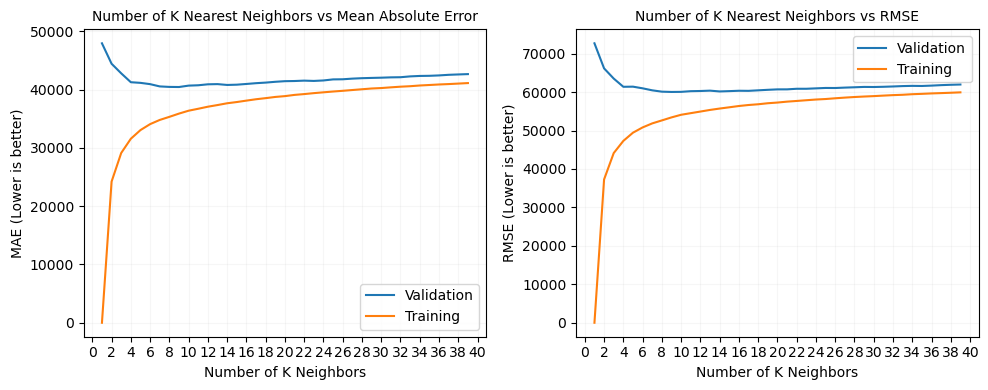

In [8]:

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10,4), sharex=False, sharey=False)

axes[0].plot(range(1,40), mae_error_knn_elbow_01_valid, label='Validation')
axes[0].plot(range(1,40), mae_error_knn_elbow_01_train, label='Training')

axes[0].set_xticks(range(0, 41, 2))
axes[0].set_xlabel("Number of K Neighbors", fontsize=10)
axes[0].set_ylabel("MAE (Lower is better)", fontsize=10)
axes[0].set_title("Number of K Nearest Neighbors vs Mean Absolute Error", fontsize=10)
axes[0].legend(loc=('best'))
axes[0].grid(alpha=0.1)




axes[1].plot(range(1,40), rmse_error_knn_elbow_01_valid, label='Validation')
axes[1].plot(range(1,40), rmse_error_knn_elbow_01_train, label='Training')

axes[1].set_xticks(range(0, 41, 2))
axes[1].set_xlabel("Number of K Neighbors", fontsize=10)
axes[1].set_ylabel("RMSE (Lower is better)", fontsize=10)
axes[1].set_title("Number of K Nearest Neighbors vs RMSE", fontsize=10)
axes[1].legend(loc=('best'))
axes[1].grid(alpha=0.1)
plt.tight_layout()


plt.show()


In [ ]:
#plt.figure(figsize=(8,6))
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10,4), sharex=False, sharey=False)

axes[0].plot(range(1,40), mae_error_knn_elbow_01_valid, label='Validation')
axes[0].plot(range(1,40), mae_error_knn_elbow_01_train, label='Training')

axes[0].set_xticks(range(0, 41, 2))
axes[0].set_xlim(0, 12)
axes[0].set_ylim(30000, 50000)
axes[0].set_xlabel("Number of K Neighbors", fontsize=10)
axes[0].set_ylabel("MAE (Lower is better)", fontsize=10)
axes[0].set_title("Number of K Nearest Neighbors vs Mean Absolute Error", fontsize=10)
axes[0].legend(loc=('best'))
axes[0].grid(alpha=0.1)

####
axes[1].plot(range(1,40), rmse_error_knn_elbow_01_valid, label='Validation')
axes[1].plot(range(1,40), rmse_error_knn_elbow_01_train, label='Training')

axes[1].set_xticks(range(0, 41, 2))
axes[1].set_xlim(0, 12)
axes[1].set_ylim(50000, 70000)
axes[1].set_xlabel("Number of K Neighbors", fontsize=10)
axes[1].set_ylabel("RMSE (Lower is better)", fontsize=10)
axes[1].set_title("Number of K Nearest Neighbors vs RMSE", fontsize=10)
axes[1].legend(loc=('best'))
axes[1].grid(alpha=0.1)
plt.tight_layout()

plt.show()

## The best n_neighbors seems to be between either 4, 6, 7, and 8
## Further inspection on DataFrame below

## KNN 4 neighbors

In [9]:
from sklearn.neighbors import KNeighborsRegressor
#from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error

knn_model_001_002 = KNeighborsRegressor(n_neighbors=4,## Default 5
                                             weights='uniform',
                                             algorithm='auto',
                                             leaf_size=30,
                                             p=2,
                                             metric='minkowski',
                                             metric_params=None,
                                             n_jobs=None)

knn_model_001_002.fit(X_train, y_train)


KNeighborsRegressor(n_neighbors=4)

In [10]:
## Model predictions - Validation set
knn_model_001_002_valid_preds = knn_model_001_002.predict(X_valid)

mae_score_knn_model_001_002_valid = mean_absolute_error(y_true=y_valid, y_pred=knn_model_001_002_valid_preds, sample_weight=None, multioutput='uniform_average')
rmse_score_knn_model_001_002_valid = np.sqrt(mean_squared_error(y_true=y_valid,y_pred=knn_model_001_002_valid_preds,sample_weight=None,multioutput='uniform_average',squared=True))


knn_model_001_002_valid_preds = knn_model_001_002.predict(X_valid)


model_stats(model=knn_model_001_002, model_used=KNeighborsRegressor, model_name=knn_model_001_002, param_grid_used=False)



mae_score_knn_model_001_002_val = []
rmse_score_knn_model_001_002_val = []
explained_var_score_knn_model_001_002_val = []
r2_score_knn_model_001_002_val = []

show_model_metrics_regression(model=knn_model_001_002, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_knn_model_001_002_val,
                                  rmse_score_list=rmse_score_knn_model_001_002_val,
                                  explained_var_score_list=explained_var_score_knn_model_001_002_val,
                                  r2_score_list=r2_score_knn_model_001_002_val)



Model: <class 'sklearn.neighbors._regression.KNeighborsRegressor'>
 Model Object Variable Name: KNeighborsRegressor(n_neighbors=4)
Trained Model Variable Name: KNeighborsRegressor(n_neighbors=4)


  Median of y: 179700.0
y_test Median: 182000.0


  Mean of y: 206864.41315519012
y_test Mean: 209672.04796867352


 MAE: 41275.47466960352  -> 41275.4747
RMSE: 61374.900387250156 -> 61374.9004
R2 Coefficient of Determination: 0.7226607930167243 -> 0.7227


Model RMSE is 61374.9004 and that is on the 29.669144 % error range
explained_var_score: 0.7238652986396551




#### SVM
Scaling: Yes
**SVM Regressor**

In [11]:
## SVM Support Vector Machine - Support Vector Regressor - Grid Search
from sklearn.svm import SVR
from sklearn.model_selection import GridSearchCV

## Default
svm_model_001_001 = SVR(kernel='rbf',
                        degree=3,
                        gamma='scale',
                        coef0=0.0,
                        tol=0.001,
                        C=1.0,
                        epsilon=0.1,
                        shrinking=True,
                        cache_size=200,
                        verbose=False,
                        max_iter=-1)

param_grid = {'C':[0.001, 0.01, 0.1, 0.5, 1],
              'kernel':['linear', 'rbf'],# 'poly'],
              'gamma':['auto'],
              'degree':[3, 4],
              'epsilon':[0, 0.01, 0.1, 0.5, 1, 2]}

grid_svm_model_001_001 = GridSearchCV(estimator=svm_model_001_001,
                                      param_grid=param_grid,
                                      scoring=None,
                                      n_jobs=None,
                                      refit=True,
                                      cv=None,
                                      verbose=1,
                                      pre_dispatch='2*n_jobs',
                                      return_train_score=False)

grid_svm_model_001_001.fit(X_train, y_train)


Fitting 5 folds for each of 120 candidates, totalling 600 fits


KeyboardInterrupt: 

In [ ]:
grid_svm_model_001_001.best_params_
#{'C': 1, 'degree': 3, 'epsilon': 0.1, 'gamma': 'auto', 'kernel': 'linear'}

In [ ]:
#svm_model_001_001 - SVR

grid_svm_model_001_001_valid_preds = grid_svm_model_001_001.predict(X_valid)
model_stats(model=grid_svm_model_001_001, model_used=SVR, model_name=svm_model_001_001, param_grid_used=True)


mae_score_grid_svm_model_001_001_val = []
rmse_score_grid_svm_model_001_001_val = []
explained_var_score_grid_svm_model_001_001_val = []
r2_score_grid_svm_model_001_001_val = []

show_model_metrics_regression(model=grid_svm_model_001_001, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_grid_svm_model_001_001_val,
                                  rmse_score_list=rmse_score_grid_svm_model_001_001_val,
                                  explained_var_score_list=explained_var_score_grid_svm_model_001_001_val,
                                  r2_score_list=r2_score_grid_svm_model_001_001_val)




#### Decision Trees and Random Forest
Scaling: Not needed
**Decision Trees**
**Random Forest**




In [ ]:
## Decision Trees
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV


tree_model_001_001 = DecisionTreeRegressor(criterion='squared_error',
                                           splitter='best',
                                           max_depth=None,
                                           min_samples_split=2,
                                           min_samples_leaf=1,
                                           min_weight_fraction_leaf=0.0,
                                           max_features=None,
                                           random_state=42,## Default None
                                           max_leaf_nodes=None,
                                           min_impurity_decrease=0.0,
                                           ccp_alpha=0.0)


criterion = ["squared_error", "friedman_mse", "absolute_error", "poisson"]
splitter = ["best", "random"]

param_grid = {'criterion':criterion,
              'splitter':splitter}

grid_tree_model_001_001 = GridSearchCV(estimator=tree_model_001_001,
                                       param_grid=param_grid,
                                       scoring='neg_mean_squared_error',## Default None
                                       n_jobs=None,
                                       refit=True,
                                       cv=None,
                                       verbose=4,
                                       pre_dispatch='2*n_jobs',
                                       return_train_score=False)

grid_tree_model_001_001.fit(X_train, y_train)


In [ ]:
#Decision Trees
##grid_tree_model_001_001
grid_tree_model_001_001_valid_preds = grid_tree_model_001_001.predict(X_valid)

model_stats(model=grid_tree_model_001_001, model_used=DecisionTreeRegressor, model_name=tree_model_001_001, param_grid_used=True)


mae_score_grid_tree_model_001_001_val = []
rmse_score_grid_tree_model_001_001_val = []
explained_var_score_grid_tree_model_001_001_val = []
r2_score_grid_tree_model_001_001_val = []

show_model_metrics_regression(model=grid_tree_model_001_001, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_grid_tree_model_001_001_val,
                                  rmse_score_list=rmse_score_grid_tree_model_001_001_val,
                                  explained_var_score_list=explained_var_score_grid_tree_model_001_001_val,
                                  r2_score_list=r2_score_grid_tree_model_001_001_val)



In [ ]:
## Decision Trees
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV


tree_model_001_002 = DecisionTreeRegressor(criterion='squared_error',
                                           splitter='best',
                                           max_depth=None,
                                           min_samples_split=2,
                                           min_samples_leaf=1,
                                           min_weight_fraction_leaf=0.0,
                                           max_features=None,
                                           random_state=42,
                                           max_leaf_nodes=None,
                                           min_impurity_decrease=0.0,
                                           ccp_alpha=0.0)


criterion = ["squared_error", "friedman_mse", "absolute_error", "poisson"]
splitter = ["best", "random"]

param_grid = {'criterion':criterion,
              'splitter':splitter}

grid_tree_model_001_002 = GridSearchCV(estimator=tree_model_001_002,
                                       param_grid=param_grid,
                                       scoring=None,
                                       n_jobs=None,
                                       refit=True,
                                       cv=None,
                                       verbose=4,
                                       pre_dispatch='2*n_jobs',
                                       return_train_score=False)

grid_tree_model_001_002.fit(X_train, y_train)


In [ ]:
#Decision Trees
##grid_tree_model_001_002
grid_tree_model_001_002_valid_preds = grid_tree_model_001_002.predict(X_valid)

model_stats(model=grid_tree_model_001_002, model_used=DecisionTreeRegressor, model_name=tree_model_001_002, param_grid_used=True)


mae_score_grid_tree_model_001_002_val = []
rmse_score_grid_tree_model_001_002_val = []
explained_var_score_grid_tree_model_001_002_val = []
r2_score_grid_tree_model_001_002_val = []

show_model_metrics_regression(model=grid_tree_model_001_002, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_grid_tree_model_001_002_val,
                                  rmse_score_list=rmse_score_grid_tree_model_001_002_val,
                                  explained_var_score_list=explained_var_score_grid_tree_model_001_002_val,
                                  r2_score_list=r2_score_grid_tree_model_001_002_val)



In [ ]:
## Decision Trees
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV


tree_model_001_003 = DecisionTreeRegressor(criterion='squared_error',
                                           splitter='best',
                                           max_depth=None,
                                           min_samples_split=2,
                                           min_samples_leaf=1,
                                           min_weight_fraction_leaf=0.0,
                                           max_features=None,
                                           random_state=42,
                                           max_leaf_nodes=None,
                                           min_impurity_decrease=0.0,
                                           ccp_alpha=0.0)


criterion = ["squared_error", "friedman_mse", "absolute_error"]
splitter = ["best", "random"]

param_grid = {'criterion':criterion,
              'splitter':splitter}

grid_tree_model_001_003 = GridSearchCV(estimator=tree_model_001_003,
                                       param_grid=param_grid,
                                       scoring=None,
                                       n_jobs=None,
                                       refit=True,
                                       cv=None,
                                       verbose=4,
                                       pre_dispatch='2*n_jobs',
                                       return_train_score=False)

grid_tree_model_001_003.fit(X_train, y_train)


In [ ]:
#Decision Trees
##grid_tree_model_001_003
grid_tree_model_001_003_valid_preds = grid_tree_model_001_003.predict(X_valid)

model_stats(model=grid_tree_model_001_003, model_used=DecisionTreeRegressor, model_name=tree_model_001_003, param_grid_used=True)

mae_score_grid_tree_model_001_003_val = []
rmse_score_grid_tree_model_001_003_val = []
explained_var_score_grid_tree_model_001_003_val = []
r2_score_grid_tree_model_001_003_val = []

show_model_metrics_regression(model=grid_tree_model_001_003, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_grid_tree_model_001_003_val,
                                  rmse_score_list=rmse_score_grid_tree_model_001_003_val,
                                  explained_var_score_list=explained_var_score_grid_tree_model_001_003_val,
                                  r2_score_list=r2_score_grid_tree_model_001_003_val)



# Random Forest

#### Decision Trees and Random Forest
Scaling: Not needed
Decision Trees
**Random Forest**

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV


forest_model_001_001 = RandomForestRegressor(n_estimators=100,
                                              criterion='squared_error',
                                              max_depth=None,
                                              min_samples_split=2,
                                              min_samples_leaf=1,
                                              min_weight_fraction_leaf=0.0,
                                              max_features=1.0,
                                              max_leaf_nodes=None,
                                              min_impurity_decrease=0.0,
                                              bootstrap=True,
                                              oob_score=False,
                                              n_jobs=None,
                                              random_state=42,## Default None
                                              verbose=0,
                                              warm_start=False,
                                              ccp_alpha=0.0,
                                              max_samples=None)

n_estimators=[64, 100, 128, 200]
max_features=[2, 3, 4]
bootstrap=[True, False]
oob_score=[True, False]

param_grid = {'n_estimators':n_estimators,
              'max_features':max_features,
              'bootstrap':bootstrap,
              'oob_score':oob_score}


grid_forest_model_001_001 = GridSearchCV(estimator=forest_model_001_001,
                                         param_grid=param_grid,
                                         scoring=None,
                                         n_jobs=None,
                                         refit=True,
                                         cv=None,
                                         verbose=3,
                                         pre_dispatch='2*n_jobs',
                                         return_train_score=False)

grid_forest_model_001_001.fit(X_train, y_train)


In [ ]:
#Random Forest
#grid_forest_model_001_001
grid_forest_model_001_001_valid_preds = grid_forest_model_001_001.predict(X_valid)



model_stats(model=grid_forest_model_001_001, model_used=RandomForestRegressor, model_name=forest_model_001_001, param_grid_used=True)


mae_score_grid_tree_model_001_003_val = []
rmse_score_grid_tree_model_001_003_val = []
explained_var_score_grid_tree_model_001_003_val = []
r2_score_grid_tree_model_001_003_val = []

show_model_metrics_regression(model=grid_forest_model_001_001, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_grid_tree_model_001_003_val,
                                  rmse_score_list=rmse_score_grid_tree_model_001_003_val,
                                  explained_var_score_list=explained_var_score_grid_tree_model_001_003_val,
                                  r2_score_list=r2_score_grid_tree_model_001_003_val)



In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV

forest_model_001_002 =  RandomForestRegressor(n_estimators=100,
                                              criterion='squared_error',
                                              max_depth=None,
                                              min_samples_split=2,
                                              min_samples_leaf=1,
                                              min_weight_fraction_leaf=0.0,
                                              max_features=1.0,
                                              max_leaf_nodes=None,
                                              min_impurity_decrease=0.0,
                                              bootstrap=True,
                                              oob_score=False,
                                              n_jobs=None,
                                              random_state=42,## Default None
                                              verbose=0,
                                              warm_start=False,
                                              ccp_alpha=0.0,
                                              max_samples=None)

n_estimators=[64, 100, 128, 200, 240, 280, 300]
max_features=[2, 3, 4]
bootstrap=[True, False]
oob_score=[True, False]

param_grid = {'n_estimators':n_estimators,
              'max_features':max_features,
              'bootstrap':bootstrap,
              'oob_score':oob_score}


grid_forest_model_001_002 = GridSearchCV(estimator=forest_model_001_002,
                                         param_grid=param_grid,
                                         scoring=None,
                                         n_jobs=None,
                                         refit=True,
                                         cv=None,
                                         verbose=3,
                                         pre_dispatch='2*n_jobs',
                                         return_train_score=False)

grid_forest_model_001_002.fit(X_train, y_train)


In [ ]:
#Random Forest
##grid_forest_model_001_002
grid_forest_model_001_002_valid_preds = grid_forest_model_001_002.predict(X_valid)



model_stats(model=grid_forest_model_001_002, model_used=RandomForestRegressor, model_name=forest_model_001_002, param_grid_used=True)

mae_score_grid_forest_model_001_002_val = []
rmse_score_grid_forest_model_001_002_val = []
explained_var_score_grid_forest_model_001_002_val = []
r2_score_grid_forest_model_001_002_val = []

show_model_metrics_regression(model=grid_forest_model_001_002, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_grid_forest_model_001_002_val,
                                  rmse_score_list=rmse_score_grid_forest_model_001_002_val,
                                  explained_var_score_list=explained_var_score_grid_forest_model_001_002_val,
                                  r2_score_list=r2_score_grid_forest_model_001_002_val)



#### Boosting Techniques
Scaling: Not needed \
**AdaBoost** \
**Gradient Boosting**

In [ ]:
from sklearn.ensemble import AdaBoostRegressor, GradientBoostingRegressor
from sklearn.model_selection import GridSearchCV


AdaBoostRegressor_model_001_001 = AdaBoostRegressor(estimator=None,
                                                    n_estimators=50,
                                                    learning_rate=1.0,
                                                    loss='linear',
                                                    random_state=42)

n_estimators = [20, 50, 80]
learning_rate = [0.5, 1.0, 1.5]
loss = ['linear', 'square', 'exponential']
random_state=42
base_estimator = None

param_grid = {'n_estimators':n_estimators,
              'learning_rate':learning_rate,
              'loss':loss}


grid_adaboost_model_001_001 = GridSearchCV(estimator=AdaBoostRegressor_model_001_001,
                                       param_grid=param_grid,
                                       scoring='neg_mean_squared_error',
                                       n_jobs=None,
                                       refit=True,
                                       cv=None,
                                       verbose=4,
                                       pre_dispatch='2*n_jobs',
                                       return_train_score=False)

grid_adaboost_model_001_001.fit(X_train, y_train)



In [ ]:
##AdaBoost
##grid_adaboost_model_001_001

grid_adaboost_model_001_001_valid_preds = grid_adaboost_model_001_001.predict(X_valid)
model_stats(model=grid_adaboost_model_001_001, model_used=AdaBoostRegressor, model_name=grid_adaboost_model_001_001, param_grid_used=True)

mae_score_grid_adaboost_model_001_001_val = []
rmse_score_grid_adaboost_model_001_001_val = []
explained_var_score_grid_adaboost_model_001_001_val = []
r2_score_grid_adaboost_model_001_001_val = []

show_model_metrics_regression(model=grid_adaboost_model_001_001, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_grid_adaboost_model_001_001_val,
                                  rmse_score_list=rmse_score_grid_adaboost_model_001_001_val,
                                  explained_var_score_list=explained_var_score_grid_adaboost_model_001_001_val,
                                  r2_score_list=r2_score_grid_adaboost_model_001_001_val)



In [ ]:
##Best Estimator Chosen:
##AdaBoostRegressor(learning_rate=0.5, loss='exponential', n_estimators=20,
##                  random_state=42)

from sklearn.ensemble import AdaBoostRegressor, GradientBoostingRegressor
from sklearn.model_selection import GridSearchCV


AdaBoostRegressor_model_001_002 = AdaBoostRegressor(estimator=None,
                                                    n_estimators=50,
                                                    learning_rate=1.0,
                                                    loss='linear',
                                                    random_state=42)

n_estimators = [20, 50, 80]
learning_rate = [1.0, 1.5]
loss = ['linear', 'square', 'exponential']
random_state=42
base_estimator = None

param_grid = {'n_estimators':n_estimators,
              'learning_rate':learning_rate,
              'loss':loss}


grid_adaboost_model_001_002 = GridSearchCV(estimator=AdaBoostRegressor_model_001_002,
                                       param_grid=param_grid,
                                       scoring='neg_mean_squared_error',
                                       n_jobs=None,
                                       refit=True,
                                       cv=None,
                                       verbose=4,
                                       pre_dispatch='2*n_jobs',
                                       return_train_score=False)

grid_adaboost_model_001_002.fit(X_train, y_train)


In [ ]:
##AdaBoost
##grid_adaboost_model_001_002
grid_adaboost_model_001_002_valid_preds = grid_adaboost_model_001_002.predict(X_valid)


model_stats(model=grid_adaboost_model_001_002, model_used=AdaBoostRegressor, model_name=AdaBoostRegressor_model_001_002, param_grid_used=True)

mae_score_grid_adaboost_model_001_002_val = []
rmse_score_grid_adaboost_model_001_002_val = []
explained_var_score_grid_adaboost_model_001_002_val = []
r2_score_grid_adaboost_model_001_002_val = []

show_model_metrics_regression(model=grid_adaboost_model_001_002, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_grid_adaboost_model_001_002_val,
                                  rmse_score_list=rmse_score_grid_adaboost_model_001_002_val,
                                  explained_var_score_list=explained_var_score_grid_adaboost_model_001_002_val,
                                  r2_score_list=r2_score_grid_adaboost_model_001_002_val)



In [ ]:
##Best Estimator Chosen:
##AdaBoostRegressor(learning_rate=0.5, loss='exponential', n_estimators=20,
##                  random_state=42)

from sklearn.ensemble import AdaBoostRegressor, GradientBoostingRegressor
from sklearn.model_selection import GridSearchCV

AdaBoostRegressor_model_001_003 = AdaBoostRegressor(estimator=None,
                                                    n_estimators=50,
                                                    learning_rate=1.0,
                                                    loss='linear',
                                                    random_state=42)

n_estimators = [15, 20, 50, 80]
learning_rate = [0.3, 0.5, 1.0, 1.5]
loss = ['linear', 'square', 'exponential']

param_grid = {'n_estimators':n_estimators,
              'learning_rate':learning_rate,
              'loss':loss}


grid_adaboost_model_001_003 = GridSearchCV(estimator=AdaBoostRegressor_model_001_003,
                                       param_grid=param_grid,
                                       scoring='neg_mean_squared_error',
                                       n_jobs=None,
                                       refit=True,
                                       cv=None,
                                       verbose=4,
                                       pre_dispatch='2*n_jobs',
                                       return_train_score=False)

grid_adaboost_model_001_003.fit(X_train, y_train)


In [ ]:
##AdaBoost
##grid_adaboost_model_001_003
grid_adaboost_model_001_003_valid_preds = grid_adaboost_model_001_003.predict(X_valid)


model_stats(model=grid_adaboost_model_001_003, model_used=AdaBoostRegressor, model_name=AdaBoostRegressor_model_001_003, param_grid_used=True)

mae_score_grid_adaboost_model_001_003_val = []
rmse_score_grid_adaboost_model_001_003_val = []
explained_var_score_grid_adaboost_model_001_003_val = []
r2_score_grid_adaboost_model_001_003_val = []

show_model_metrics_regression(model=grid_adaboost_model_001_003, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_grid_adaboost_model_001_003_val,
                                  rmse_score_list=rmse_score_grid_adaboost_model_001_003_val,
                                  explained_var_score_list=explained_var_score_grid_adaboost_model_001_003_val,
                                  r2_score_list=r2_score_grid_adaboost_model_001_003_val)



# Gradient Boosting

In [ ]:
##Gradient Boosting
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import GridSearchCV

GradBoostRegressor_model_001_001 = GradientBoostingRegressor(loss='squared_error',
                                                            learning_rate=0.1,
                                                            n_estimators=100,
                                                            subsample=1.0,
                                                            criterion='friedman_mse',
                                                            min_samples_split=2,
                                                            min_samples_leaf=1,
                                                            min_weight_fraction_leaf=0.0,
                                                            max_depth=3,
                                                            min_impurity_decrease=0.0,
                                                            init=None,
                                                            random_state=42,
                                                            max_features=None,
                                                            alpha=0.9,
                                                            verbose=0,
                                                            max_leaf_nodes=None,
                                                            warm_start=False,
                                                            validation_fraction=0.1,
                                                            n_iter_no_change=None,
                                                            tol=0.0001,
                                                            ccp_alpha=0.0)

learning_rate = [0.05, 0.1, 0.2, 0.5]
n_estimators = [20, 50, 80, 100, 120]
max_depth=[3, 4, 5]
#alpha = [0.1, 0.3, 0.5, 0.9, 1.0]
subsample = [0.3, 0.5, 1.0]


param_grid = {'learning_rate':learning_rate,
              'n_estimators':n_estimators,
              'max_depth':max_depth,
              'subsample':subsample}


grid_gradboost_model_001_001 = GridSearchCV(estimator=GradBoostRegressor_model_001_001,
                                       param_grid=param_grid,
                                       scoring='neg_mean_squared_error',## Default None
                                       n_jobs=None,
                                       refit=True,
                                       cv=None,
                                       verbose=4,
                                       pre_dispatch='2*n_jobs',
                                       return_train_score=False)

grid_gradboost_model_001_001.fit(X_train, y_train)


In [ ]:
##Gradient Boosting
##grid_gradboost_model_001_001

grid_gradboost_model_001_001_valid_preds = grid_gradboost_model_001_001.predict(X_valid)


model_stats(model=grid_gradboost_model_001_001, model_used=GradientBoostingRegressor, model_name=GradBoostRegressor_model_001_001, param_grid_used=True)

mae_score_grid_gradboost_model_001_001_val = []
rmse_score_grid_gradboost_model_001_001_val = []
explained_var_score_grid_gradboost_model_001_001_val = []
r2_score_grid_gradboost_model_001_001_val = []

show_model_metrics_regression(model=grid_gradboost_model_001_001, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_grid_gradboost_model_001_001_val,
                                  rmse_score_list=rmse_score_grid_gradboost_model_001_001_val,
                                  explained_var_score_list=explained_var_score_grid_gradboost_model_001_001_val,
                                  r2_score_list=r2_score_grid_gradboost_model_001_001_val)


In [ ]:
##Gradient Boosting
##Best Parameters: {'learning_rate': 0.2, 'max_depth': 4, 'n_estimators': 120, 'subsample': 1.0}
##Best Estimator Chosen: GradientBoostingRegressor(learning_rate=0.2, max_depth=4, n_estimators=120, random_state=42)

from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import GridSearchCV

GradBoostRegressor_model_001_002 = GradientBoostingRegressor(loss='squared_error',
                                                            learning_rate=0.1,
                                                            n_estimators=100,
                                                            subsample=1.0,
                                                            criterion='friedman_mse',
                                                            min_samples_split=2,
                                                            min_samples_leaf=1,
                                                            min_weight_fraction_leaf=0.0,
                                                            max_depth=3,
                                                            min_impurity_decrease=0.0,
                                                            init=None,
                                                            random_state=42,
                                                            max_features=None,
                                                            alpha=0.9,
                                                            verbose=0,
                                                            max_leaf_nodes=None,
                                                            warm_start=False,
                                                            validation_fraction=0.1,
                                                            n_iter_no_change=None,
                                                            tol=0.0001,
                                                            ccp_alpha=0.0)

## Best Parameters for GradBoostRegressor_model_001_001
#Best Parameters: {'learning_rate': 0.2, 'max_depth': 4, 'n_estimators': 120, 'subsample': 1.0}
#Best Estimator Chosen: GradientBoostingRegressor(learning_rate=0.2, max_depth=4, n_estimators=120, random_state=42)

learning_rate = [0.1, 0.2, 0.25, 0.3, 0.5]
n_estimators = [80, 100, 120, 130]
max_depth=[3, 4, 5]
subsample = [0.3, 0.5, 1.0]


param_grid = {'learning_rate':learning_rate,
              'n_estimators':n_estimators,
              'max_depth':max_depth,
              'subsample':subsample}


grid_gradboost_model_001_002 = GridSearchCV(estimator=GradBoostRegressor_model_001_002,
                                       param_grid=param_grid,
                                       scoring='neg_mean_squared_error',## Default None
                                       n_jobs=None,
                                       refit=True,
                                       cv=None,
                                       verbose=4,
                                       pre_dispatch='2*n_jobs',
                                       return_train_score=False)


grid_gradboost_model_001_002.fit(X_train, y_train)


In [ ]:
##Gradient Boosting
##GradBoostRegressor_model_001_002
grid_gradboost_model_001_002_valid_preds = grid_gradboost_model_001_002.predict(X_valid)

model_stats(model=grid_gradboost_model_001_002, model_used=GradientBoostingRegressor, model_name=GradBoostRegressor_model_001_002, param_grid_used=True)

mae_score_grid_gradboost_model_001_002_val = []
rmse_score_grid_gradboost_model_001_002_val = []
explained_var_score_grid_gradboost_model_001_002_val = []
r2_score_grid_gradboost_model_001_002_val = []

show_model_metrics_regression(model=grid_gradboost_model_001_002, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_grid_gradboost_model_001_002_val,
                                  rmse_score_list=rmse_score_grid_gradboost_model_001_002_val,
                                  explained_var_score_list=explained_var_score_grid_gradboost_model_001_002_val,
                                  r2_score_list=r2_score_grid_gradboost_model_001_002_val)


## XGBoost
### XGBRegressor

In [36]:
import xgboost as xg
from sklearn.model_selection import GridSearchCV
#XGBRegressor_model_001_001 = xg.XGBRegressor(objective='reg:linear', n_estimators=10, seed=42)
#XGBRegressor_model_001_001.fit(X_train.values, y_train.values)


XGBRegressor_model_001_001 = xg.XGBRegressor()

objective=['reg:linear']
n_estimators=[10]
seed = [42]

param_grid = {'objective':objective,
              'n_estimators':n_estimators,
              'seed':seed}

grid_XGBRegressor_model_001_001 = GridSearchCV(estimator=XGBRegressor_model_001_001,
                                                 param_grid=param_grid,
                                                 scoring=None,
                                                 n_jobs=None,
                                                 refit=True,
                                                 cv=None,
                                                 verbose=4,
                                                 pre_dispatch='2*n_jobs',
                                                 return_train_score=False)

##ValueError: feature_names must be string, and may not contain [, ] or <
#grid_XGBRegressor_model_001_001.fit(X_train, y_train)
grid_XGBRegressor_model_001_001.fit(X_train.values, y_train.values)




Fitting 5 folds for each of 1 candidates, totalling 5 fits
[19:07:07] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1693020860993/work/src/objective/regression_obj.cu:213: reg:linear is now deprecated in favor of reg:squarederror.
[CV 1/5] END n_estimators=10, objective=reg:linear, seed=42;, score=0.779 total time=   0.1s
[19:07:07] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1693020860993/work/src/objective/regression_obj.cu:213: reg:linear is now deprecated in favor of reg:squarederror.
[CV 2/5] END n_estimators=10, objective=reg:linear, seed=42;, score=0.748 total time=   0.0s
[19:07:08] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1693020860993/work/src/objective/regression_obj.cu:213: reg:linear is now deprecated in favor of reg:squarederror.
[CV 3/5] END n_estimators=10, objective=reg:linear, seed=42;, score=0.781 total time=   0.0s
[19:07:08] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1693020860993/work/src/objective/regressi

GridSearchCV(estimator=XGBRegressor(base_score=None, booster=None,
                                    callbacks=None, colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None,
                                    early_stopping_rounds=None,
                                    enable_categorical=False, eval_metric=None,
                                    feature_types=None, gamma=None, gpu_id=None,
                                    grow_policy=None, importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None, max_bin=None,
                                    max_cat_threshold=None,
                                    max_cat_to_onehot=None, max_delta_step=None,
                                    max_depth=None, max_leaves=None,
                                    min_child_weight=None, missing=nan,
                                    monotone_constraints=None, n_estimators=100,
                                    n_jobs=None, num_parallel_tree=None,
                                    predictor=None, random_state=None, ...),
             param_grid={'n_estimators': [10], 'objective': ['reg:linear'],
                         'seed': [42]},
             verbose=4)

In [37]:
###############     ###############     ###############     ###############
##XGBoost
#XGBRegressor_model_001_001
#XGBRegressor
#grid_XGBRegressor_model_001_001

grid_XGBRegressor_model_001_001_valid_preds = grid_XGBRegressor_model_001_001.predict(X_valid)

model_stats(model=grid_XGBRegressor_model_001_001, model_used=XGBRegressor, model_name=XGBRegressor_model_001_001, param_grid_used=True)

mae_score_grid_XGBRegressor_model_001_001_val = []
rmse_score_grid_XGBRegressor_model_001_001_val = []
explained_var_score_XGBRegressor_model_001_001_val = []
r2_score_grid_XGBRegressor_model_001_001_val = []

show_model_metrics_regression(model=grid_XGBRegressor_model_001_001, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_grid_XGBRegressor_model_001_001_val,
                                  rmse_score_list=rmse_score_grid_XGBRegressor_model_001_001_val,
                                  explained_var_score_list=explained_var_score_XGBRegressor_model_001_001_val,
                                  r2_score_list=r2_score_grid_XGBRegressor_model_001_001_val)





Model: <class 'xgboost.sklearn.XGBRegressor'>
 Model Object Variable Name: XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...)
Trained Model Variable Name: GridSearchCV(estimator=XGBRegressor(base_score=None, booster=None,
                                    callbacks=None, colsample_bylevel=None,
            

In [42]:

print(f"Best Estimator:\n{grid_XGBRegressor_model_001_001.best_estimator_}")
print("\n")
print(f"Best Params:\n{grid_XGBRegressor_model_001_001.best_params_}")
print("\n")
##grid_XGBRegressor_model_001_001
##{'n_estimators': 10, 'objective': 'reg:linear', 'seed': 42}

Best Estimator:
XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=10, n_jobs=None, num_parallel_tree=None,
             objective='reg:linear', predictor=None, ...)


Best Params:
{'n_estimators': 10, 'objective': 'reg:linear', 'seed': 42}




## XGBoost
### XGBRFRegressor

In [38]:
###############     ###############     ###############     ###############


import xgboost as xg
from sklearn.model_selection import GridSearchCV

XGBRFRegressor_model_001_001 = xg.XGBRFRegressor()

#params = {'tree_method':'gpu_hist',
#         'predictor':'cpu_predictor',
#          'n_jobs':-1,
#          'seed':42
#         }

learning_rate = [1.0]
subsample = [0.8]
colsample_bynode = [0.8]
reg_lambda = [1e-05]

param_grid = {'learning_rate':learning_rate,
              'subsample':subsample,
              'colsample_bynode':colsample_bynode,
              'reg_lambda':reg_lambda}

grid_XGBRFRegressor_model_001_001 = GridSearchCV(estimator=XGBRFRegressor_model_001_001,
                                                 param_grid=param_grid,
                                                 scoring=None,
                                                 n_jobs=None,
                                                 refit=True,
                                                 cv=None,
                                                 verbose=4,
                                                 pre_dispatch='2*n_jobs',
                                                 return_train_score=False)

##ValueError: feature_names must be string, and may not contain [, ] or <
#grid_XGBRFRegressor_model_001_001.fit(X_train, y_train)
grid_XGBRFRegressor_model_001_001.fit(X_train.values, y_train.values)

###############     ###############     ###############     ###############


Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END colsample_bynode=0.8, learning_rate=1.0, reg_lambda=1e-05, subsample=0.8;, score=0.712 total time=   0.4s
[CV 2/5] END colsample_bynode=0.8, learning_rate=1.0, reg_lambda=1e-05, subsample=0.8;, score=0.660 total time=   0.4s
[CV 3/5] END colsample_bynode=0.8, learning_rate=1.0, reg_lambda=1e-05, subsample=0.8;, score=0.716 total time=   0.4s
[CV 4/5] END colsample_bynode=0.8, learning_rate=1.0, reg_lambda=1e-05, subsample=0.8;, score=0.702 total time=   0.4s
[CV 5/5] END colsample_bynode=0.8, learning_rate=1.0, reg_lambda=1e-05, subsample=0.8;, score=0.689 total time=   0.4s


GridSearchCV(estimator=XGBRFRegressor(base_score=None, booster=None,
                                      callbacks=None, colsample_bylevel=None,
                                      colsample_bytree=None,
                                      early_stopping_rounds=None,
                                      enable_categorical=False,
                                      eval_metric=None, feature_types=None,
                                      gamma=None, gpu_id=None, grow_policy=None,
                                      importance_type=None,
                                      interaction_constraints=None,
                                      max_bin=None, max_cat_threshold=None,
                                      max_cat_t...
                                      max_delta_step=None, max_depth=None,
                                      max_leaves=None, min_child_weight=None,
                                      missing=nan, monotone_constraints=None,
                                      n_estimators=100, n_jobs=None,
                                      num_parallel_tree=None,
                                      objective='reg:squarederror',
                                      predictor=None, random_state=None,
                                      reg_alpha=None, ...),
             param_grid={'colsample_bynode': [0.8], 'learning_rate': [1.0],
                         'reg_lambda': [1e-05], 'subsample': [0.8]},
             verbose=4)

In [39]:

##XGBoost
##XGBRFRegressor
##XGBRFRegressor_model_001_001
##grid_XGBRFRegressor_model_001_001

grid_XGBRFRegressor_model_001_001_valid_preds = grid_XGBRFRegressor_model_001_001.predict(X_valid)

model_stats(model=grid_XGBRFRegressor_model_001_001, model_used=XGBRFRegressor, model_name=XGBRFRegressor_model_001_001, param_grid_used=True)

mae_score_grid_XGBRFRegressor_model_001_001_val = []
rmse_score_grid_XGBRFRegressor_model_001_001_val = []
explained_var_score_XGBRFRegressor_model_001_001_val = []
r2_score_grid_XGBRFRegressor_model_001_001_val = []

show_model_metrics_regression(model=grid_XGBRFRegressor_model_001_001, X_test=X_valid, y_test=y_valid, whole_y=y, 
                                  to_append=True, 
                                  mae_score_list=mae_score_grid_XGBRFRegressor_model_001_001_val,
                                  rmse_score_list=rmse_score_grid_XGBRFRegressor_model_001_001_val,
                                  explained_var_score_list=explained_var_score_XGBRFRegressor_model_001_001_val,
                                  r2_score_list=r2_score_grid_XGBRFRegressor_model_001_001_val)





Model: <class 'xgboost.sklearn.XGBRFRegressor'>
 Model Object Variable Name: XGBRFRegressor(base_score=None, booster=None, callbacks=None,
               colsample_bylevel=None, colsample_bytree=None,
               early_stopping_rounds=None, enable_categorical=False,
               eval_metric=None, feature_types=None, gamma=None, gpu_id=None,
               grow_policy=None, importance_type=None,
               interaction_constraints=None, max_bin=None,
               max_cat_threshold=None, max_cat_to_onehot=None,
               max_delta_step=None, max_depth=None, max_leaves=None,
               min_child_weight=None, missing=nan, monotone_constraints=None,
               n_estimators=100, n_jobs=None, num_parallel_tree=None,
               objective='reg:squarederror', predictor=None, random_state=None,
               reg_alpha=None, ...)
Trained Model Variable Name: GridSearchCV(estimator=XGBRFRegressor(base_score=None, booster=None,
                                      callba

In [43]:
print(f"Best Estimator:\n{grid_XGBRFRegressor_model_001_001.best_estimator_}")
print("\n")
print(f"Best Params:\n{grid_XGBRFRegressor_model_001_001.best_params_}")
print("\n")
##grid_XGBRFRegressor_model_001_001
##{'colsample_bynode': 0.8, 'learning_rate': 1.0, 'reg_lambda': 1e-05, 'subsample': 0.8}



Best Estimator:
XGBRFRegressor(base_score=None, booster=None, callbacks=None,
               colsample_bylevel=None, colsample_bytree=None,
               early_stopping_rounds=None, enable_categorical=False,
               eval_metric=None, feature_types=None, gamma=None, gpu_id=None,
               grow_policy=None, importance_type=None,
               interaction_constraints=None, max_bin=None,
               max_cat_threshold=None, max_cat_to_onehot=None,
               max_delta_step=None, max_depth=None, max_leaves=None,
               min_child_weight=None, missing=nan, monotone_constraints=None,
               n_estimators=100, n_jobs=None, num_parallel_tree=None,
               objective='reg:squarederror', predictor=None, random_state=None,
               reg_alpha=None, ...)


Best Params:
{'colsample_bynode': 0.8, 'learning_rate': 1.0, 'reg_lambda': 1e-05, 'subsample': 0.8}




<div style="padding:8px; color:#ECEEF1; margin:0.3; font-size:190%; text-align:center; display:fill; border-radius:5px; background-color:#617A9A; overflow:hidden; font-weight:270; font-family:helvetica;"> Notebook 002</div>
<br>

In [ ]:
/Users/luis/Documents/Proyects_To_Export/0261_DS_Projects/venv_0261_DS_Projects_311/Projects/0261_Project_002/0261_Project_002_Notebooks_Mine/0261_Project_002_00_To_Pre_Export/To_Pre_Export/0001 0006 004 01 Models Part 001 to 7.ipynb

/Users/luis/Documents/Proyects_To_Export/0261_DS_Projects/venv_0261_DS_Projects_311/Projects/0261_Project_002/0261_Project_002_Notebooks_Mine/0261_Project_002_00_To_Pre_Export/To_Pre_Export/0001 0006 004 01 Models Part 001 to 7.ipynb/0001 0006 006 01 Model Results 01
/Users/luis/Documents/Proyects_To_Export/0261_DS_Projects/venv_0261_DS_Projects_311/Projects/0261_Project_002/0261_Project_002_Notebooks_Mine/0261_Project_002_00_To_Pre_Export/To_Pre_Export/0001 0007 002 Models Part 01.ipynb

